In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

In [ ]:
import warnings

# Suppress all warnings
warnings.filterwarnings('ignore')

# Suppress warnings of a specific type
warnings.filterwarnings('ignore', category=DeprecationWarning)

# Suppress warnings from a specific module
warnings.filterwarnings('ignore', module='pandas')

warnings.filterwarnings('ignore', module='matplotlib')

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, SimpleRNN
from tensorflow.keras.optimizers.legacy import Adam
from keras.callbacks import EarlyStopping, ReduceLROnPlateau

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!cp /content/drive/'My Drive'/YVW/new_job1.xlsx .

In [ ]:
# Read the data from an Excel file
sensor_data = pd.read_excel('new_job1.xlsx')

# Print Sensor data
sensor_data.head()

,year,month,day,hour,minute,WMS0117,WMS0103.A3_F,WMS0103.A3_P,WMS0104.A3_F,WMS0104.A3_P,WMS0116.A3_F,WMS0116.A3_P,WBS628.A3_F,WBS628.A3_P1,WBS628.A3_P2,DMA_Formula,job_id,Priority,label
0,2023,4,1,0,0,91.393029,13.095120,95.394749,10.582292,57.750720,2.331083,56.177239,11.0625,96.328125,52.81250,14.945995,NaN,NaN,0
1,2023,4,1,0,5,90.903227,13.046548,95.394749,11.197309,57.750720,2.331083,56.177239,11.3125,96.890625,52.75000,15.262439,NaN,NaN,0
2,2023,4,1,0,10,90.323462,12.389993,94.926688,10.691623,57.451958,2.035655,56.276827,11.1250,96.140625,52.53125,13.992271,NaN,NaN,0
3,2023,4,1,0,15,90.463405,11.849278,95.384790,10.127473,57.800514,2.057267,56.456084,11.1250,96.515625,52.81250,12.909018,NaN,NaN,0
4,2023,4,1,0,20,90.363446,12.919364,95.215491,10.293949,57.750720,3.145877,56.466043,11.0000,96.890625,52.59375,15.359190,NaN,NaN,0


In [ ]:
print(sensor_data.shape)

(103209, 19)


In [ ]:
print(sensor_data.dtypes)

year              int64
month             int64
day               int64
hour              int64
minute            int64
WMS0117         float64
WMS0103.A3_F    float64
WMS0103.A3_P    float64
WMS0104.A3_F    float64
WMS0104.A3_P    float64
WMS0116.A3_F    float64
WMS0116.A3_P    float64
WBS628.A3_F     float64
WBS628.A3_P1    float64
WBS628.A3_P2    float64
DMA_Formula     float64
job_id          float64
Priority        float64
label             int64
dtype: object


In [ ]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

# Define the time features and sensor features
time_features = ['year', 'month', 'day', 'hour', 'minute']
sensor_features = ['WMS0117', 'WMS0103.A3_F','WMS0103.A3_P', 'WMS0104.A3_F','WMS0104.A3_P', 'WMS0116.A3_F','WMS0116.A3_P', 'WBS628.A3_F','WBS628.A3_P1','WBS628.A3_P2', 'DMA_Formula']

In [ ]:
# Initialize scalers
time_scaler = MinMaxScaler()
sensor_scaler = StandardScaler()

# Apply scalers to respective columns
sensor_data[time_features] = time_scaler.fit_transform(sensor_data[time_features])
sensor_data[sensor_features] = sensor_scaler.fit_transform(sensor_data[sensor_features])

In [ ]:
sensor_data.head()

,year,month,day,hour,minute,WMS0117,WMS0103.A3_F,WMS0103.A3_P,WMS0104.A3_F,WMS0104.A3_P,WMS0116.A3_F,WMS0116.A3_P,WBS628.A3_F,WBS628.A3_P1,WBS628.A3_P2,DMA_Formula,job_id,Priority,label
0,0.0,0.272727,0.0,0.0,0.000000,0.289035,-0.931261,-0.070401,-0.022959,-0.018105,-1.002183,-0.615785,-0.113256,-0.095972,1.736873,-0.885851,NaN,NaN,0
1,0.0,0.272727,0.0,0.0,0.090909,-0.092755,-0.936432,-0.070401,0.095164,-0.018105,-1.002183,-0.615785,-0.063814,0.164880,1.647978,-0.858635,NaN,NaN,0
2,0.0,0.272727,0.0,0.0,0.181818,-0.544671,-1.006323,-0.472578,-0.001960,-0.221788,-1.149865,-0.529600,-0.100895,-0.182923,1.336848,-0.967877,NaN,NaN,0
3,0.0,0.272727,0.0,0.0,0.272727,-0.435588,-1.063883,-0.078958,-0.110314,0.015843,-1.139062,-0.374468,-0.100895,-0.009021,1.736873,-1.061043,NaN,NaN,0
4,0.0,0.272727,0.0,0.0,0.363636,-0.513505,-0.949971,-0.224426,-0.078339,-0.018105,-0.594875,-0.365849,-0.125616,0.164880,1.425742,-0.850314,NaN,NaN,0


In [ ]:
print(sensor_data['job_id'].unique())

[     nan 8082462. 8084826. 8084696. 8088170. 8092648. 8106850. 8109232.
 8111332. 8128832. 8137021. 8137678. 8148038. 8150875. 8156945. 8159350.
 8163187. 8165583. 8168728. 8169737. 8170439. 8178938. 8191058. 8194914.
 8195038. 8201945. 8203496. 8208781. 8217163. 8223333. 8228942. 8231996.
 8234575. 8243436. 8246469. 8248362. 8248411. 8249945. 8259300. 8272312.
 8283011. 8284261. 8287604. 8300437. 8304950. 8304966. 8309149. 8309187.
 8314397. 8314602. 8315970. 8317955. 8318250. 8320074. 8321881. 8325264.
 8325499. 8326617. 8330748. 8333566. 8339030. 8339041. 8341442. 8343471.
 8345730. 8344508. 8347859. 8348088. 8352598. 8358110. 8359922. 8362874.
 8365877. 8367222. 8367926. 8379439. 8391608. 8403207. 8409148.]


In [ ]:
print(sensor_data['Priority'].unique())

[nan  3.  1.  2.]


In [ ]:
sensor_data['job_id'] = sensor_data['job_id'].fillna(value=0)

In [ ]:
sensor_data['Priority'] = sensor_data['Priority'].fillna(value='NL')

In [ ]:
sensor_data['job_id'] = sensor_data['job_id'].astype(int)


In [ ]:
print(sensor_data['job_id'].dtype)

int64


In [ ]:
print(sensor_data['Priority'].dtype)

object


In [ ]:
unique_jobs=sensor_data['job_id'].value_counts().index

print(unique_jobs)

Index([      0, 8348088, 8325264, 8169737, 8249945, 8330748, 8201945, 8339041,
       8156945, 8320074, 8082462, 8194914, 8309149, 8231996, 8362874, 8191058,
       8318250, 8379439, 8367926, 8341442, 8284261, 8150875, 8092648, 8367222,
       8365877, 8315970, 8088170, 8208781, 8304966, 8243436, 8234575, 8409148,
       8314397, 8137021, 8111332, 8287604, 8272312, 8300437, 8352598, 8165583,
       8391608, 8168728, 8358110, 8084696, 8347859, 8084826, 8217163, 8106850,
       8163187, 8344508, 8333566, 8304950, 8343471, 8403207, 8195038, 8359922,
       8159350, 8137678, 8109232, 8309187, 8170439, 8248362, 8128832, 8223333,
       8339030, 8345730, 8314602, 8148038, 8178938, 8325499, 8259300, 8317955,
       8203496, 8326617, 8246469, 8228942, 8283011, 8321881, 8248411],
      dtype='int64', name='job_id')


In [ ]:
print(len(unique_jobs)-1)

78


In [ ]:
# Function to create sliding windows
def create_sliding_window(df, window_size=20, step_size=1):
    X, y, job_ids, priority_ids = [], [], [], []
    for start in range(0, len(df) - window_size + 1, step_size):
        end = start + window_size
        window = df.iloc[start:end]
        X.append(window.drop(columns=['label', 'job_id', 'Priority']).values)  # Exclude 'job_id' from features
        y.append(window['label'].values[-1])
        job_ids.append(window['job_id'].values)  # Collect job_ids separately
        priority_ids.append(window['Priority'].values)
    return np.array(X), np.array(y), np.array(job_ids), np.array(priority_ids)

# Prepare data using sliding window
features, target, job_ids, priority_ids = create_sliding_window(sensor_data, window_size=20)


In [ ]:
print(job_ids.shape)

(103190, 20)


In [ ]:
print(priority_ids.shape)

(103190, 20)


In [ ]:
print(features.shape)

(103190, 20, 16)


In [ ]:
# Train-test split for Validation and Testing
X_train, X_tmp, y_train, y_tmp, job_ids_train, job_ids_tmp, priority_ids_train, priority_ids_tmp = train_test_split(
    features, target, job_ids, priority_ids, test_size=0.2, random_state=0)
X_val, X_test, y_val, y_test, job_ids_val, job_ids_test, priority_ids_val, priority_ids_test = train_test_split(
    X_tmp, y_tmp, job_ids_tmp, priority_ids_tmp, test_size=0.5, random_state=0)

In [ ]:
print(features[0])

[[ 0.00000000e+00  2.72727273e-01  0.00000000e+00  0.00000000e+00
   0.00000000e+00  2.89035477e-01 -9.31261086e-01 -7.04008002e-02
  -2.29589160e-02 -1.81047384e-02 -1.00218336e+00 -6.15784656e-01
  -1.13255787e-01 -9.59717956e-02  1.73687279e+00 -8.85851039e-01]
 [ 0.00000000e+00  2.72727273e-01  0.00000000e+00  0.00000000e+00
   9.09090909e-02 -9.27554340e-02 -9.36431722e-01 -7.04008002e-02
   9.51641319e-02 -1.81047384e-02 -1.00218336e+00 -6.15784656e-01
  -6.38135420e-02  1.64880392e-01  1.64797834e+00 -8.58634902e-01]
 [ 0.00000000e+00  2.72727273e-01  0.00000000e+00  0.00000000e+00
   1.81818182e-01 -5.44671207e-01 -1.00632322e+00 -4.72577653e-01
  -1.96026432e-03 -2.21788474e-01 -1.14986502e+00 -5.29599979e-01
  -1.00895226e-01 -1.82922525e-01  1.33684776e+00 -9.67877118e-01]
 [ 0.00000000e+00  2.72727273e-01  0.00000000e+00  0.00000000e+00
   2.72727273e-01 -4.35588089e-01 -1.06388324e+00 -7.89577545e-02
  -1.10313541e-01  1.58425508e-02 -1.13906165e+00 -3.74467561e-01
  -1.00

In [ ]:
# Check data split sizes
print("Shape of Training Set: ", X_train.shape)
print("Shape of Validation Set: ", X_val.shape)
print("Shape of Testing Set: ", X_test.shape)

Shape of Training Set:  (82552, 20, 16)
Shape of Validation Set:  (10319, 20, 16)
Shape of Testing Set:  (10319, 20, 16)


In [ ]:
# Check data split sizes
print("Shape of y_train: ", y_train.shape)
print("Shape of y_val: ", y_val.shape)
print("Shape of y_test: ", y_test.shape)

Shape of y_train:  (82552,)
Shape of y_val:  (10319,)
Shape of y_test:  (10319,)


In [ ]:
# Check data split sizes
print("Shape of job ids train ", job_ids_train.shape)
print("Shape of job ids val: ", job_ids_val.shape)
print("Shape of job ids test: ", job_ids_test.shape)

Shape of job ids train  (82552, 20)
Shape of job ids val:  (10319, 20)
Shape of job ids test:  (10319, 20)


In [ ]:
# Convert to DataFrame to find unique job_ids
# Assuming each job ID array has the shape (n_samples, window_size)
job_id_train_df = pd.DataFrame(job_ids_train, columns=[f'job_id_{i}' for i in range(job_ids_train.shape[1])])
job_id_val_df = pd.DataFrame(job_ids_val, columns=[f'job_id_{i}' for i in range(job_ids_val.shape[1])])
job_id_test_df = pd.DataFrame(job_ids_test, columns=[f'job_id_{i}' for i in range(job_ids_test.shape[1])])


In [ ]:
unique_job_ids_train = job_id_train_df.melt()['value'].loc[lambda x: ~pd.isna(x) & (x != 0)].unique()
unique_job_ids_val = job_id_val_df.melt()['value'].loc[lambda x: ~pd.isna(x) & (x != 0)].unique()
unique_job_ids_test = job_id_test_df.melt()['value'].loc[lambda x: ~pd.isna(x) & (x != 0)].unique()

# Print the unique job_ids
print("Unique job_ids in Training Set (excluding NaN and 0):", unique_job_ids_train)
print("Unique job_ids in Validation Set (excluding NaN and 0):", unique_job_ids_val)
print("Unique job_ids in Testing Set (excluding NaN and 0):", unique_job_ids_test)

print("No. of Unique jobs in Train set:", len(unique_job_ids_train))
print("No. of Unique jobs in Val set:", len(unique_job_ids_val))
print("No. of Unique jobs in Test set:", len(unique_job_ids_test))

Unique job_ids in Training Set (excluding NaN and 0): [8348088 8315970 8169737 8249945 8362874 8367926 8201945 8320074 8341442
 8191058 8156945 8106850 8330748 8284261 8231996 8325264 8379439 8352598
 8150875 8082462 8137021 8347859 8339041 8208781 8088170 8217163 8084696
 8092648 8304966 8309149 8165583 8194914 8318250 8243436 8111332 8234575
 8309187 8272312 8403207 8367222 8391608 8365877 8314397 8287604 8300437
 8223333 8339030 8168728 8409148 8195038 8333566 8084826 8109232 8163187
 8304950 8358110 8314602 8344508 8343471 8128832 8345730 8248362 8359922
 8137678 8259300 8170439 8159350 8203496 8246469 8178938 8325499 8283011
 8228942 8317955 8148038 8248411 8326617 8321881]
Unique job_ids in Validation Set (excluding NaN and 0): [8191058 8272312 8320074 8348088 8201945 8339041 8231996 8156945 8169737
 8330748 8150875 8194914 8309149 8362874 8367926 8367222 8325264 8318250
 8082462 8243436 8208781 8249945 8084696 8352598 8234575 8284261 8300437
 8315970 8379439 8106850 8341442 8409

In [ ]:
# Count the number of 1s (leak scenarios) in the target sets
print("Number of leak scenarios in y_train: ", np.sum(y_train == 1))
print("Number of leak scenarios in y_val: ", np.sum(y_val == 1))
print("Number of leak scenarios in y_test: ", np.sum(y_test == 1))

Number of leak scenarios in y_train:  31381
Number of leak scenarios in y_val:  3865
Number of leak scenarios in y_test:  3896


In [ ]:
# Flatten the arrays from 2D to 1D
job_ids_train_flat = job_ids_train.flatten()
priority_ids_train_flat = priority_ids_train.flatten()

job_ids_val_flat = job_ids_val.flatten()
priority_ids_val_flat = priority_ids_val.flatten()

job_ids_test_flat = job_ids_test.flatten()
priority_ids_test_flat = priority_ids_test.flatten()

# Create DataFrames with the flattened data
train_df = pd.DataFrame({
    'job_id': job_ids_train_flat,
    'priority': priority_ids_train_flat
})

val_df = pd.DataFrame({
    'job_id': job_ids_val_flat,
    'priority': priority_ids_val_flat
})

test_df = pd.DataFrame({
    'job_id': job_ids_test_flat,
    'priority': priority_ids_test_flat
})

# Function to calculate unique job_ids per priority in a dataset
def unique_job_ids_per_priority(df, set_name):
    # Group by 'priority' and count unique job_ids
    unique_job_counts = df.groupby('priority')['job_id'].nunique()

    print(f"Unique job_ids per priority in {set_name} set:")
    print(unique_job_counts)
    print()

# For training set
unique_job_ids_per_priority(train_df, "Training")

# For validation set
unique_job_ids_per_priority(val_df, "Validation")

# For testing set
unique_job_ids_per_priority(test_df, "Testing")


Unique job_ids per priority in Training set:
priority
1.0     1
2.0    18
3.0    59
NL      1
Name: job_id, dtype: int64

Unique job_ids per priority in Validation set:
priority
1.0     1
2.0    18
3.0    59
NL      1
Name: job_id, dtype: int64

Unique job_ids per priority in Testing set:
priority
1.0     1
2.0    18
3.0    58
NL      1
Name: job_id, dtype: int64



In [ ]:
from collections import Counter

# Function to count priority occurrences
def count_priorities(priority_ids):
    # Extract the last priority from each sliding window (assuming the last one is the target)
    last_priorities = [window[-1] for window in priority_ids]
    # Count occurrences of each priority
    priority_counts = Counter(last_priorities)
    return priority_counts

# Count priorities for each set
train_priority_counts = count_priorities(priority_ids_train)
val_priority_counts = count_priorities(priority_ids_val)
test_priority_counts = count_priorities(priority_ids_test)

# Print the results
print("Training set priority counts:", train_priority_counts)
print("Validation set priority counts:", val_priority_counts)
print("Test set priority counts:", test_priority_counts)


Training set priority counts: Counter({'NL': 51171, 3.0: 29692, 2.0: 1625, 1.0: 64})
Validation set priority counts: Counter({'NL': 6454, 3.0: 3669, 2.0: 190, 1.0: 6})
Test set priority counts: Counter({'NL': 6423, 3.0: 3683, 2.0: 207, 1.0: 6})


In [ ]:
import tensorflow as tf

In [ ]:
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout

# Initialize a sequential model
lstm_model = Sequential()

# LSTM layers
lstm_model.add(LSTM(256, activation='tanh', return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
lstm_model.add(LSTM(32, activation='tanh'))

# Dense layer and Dropout Layer
lstm_model.add(Dense(16, activation='relu'))
lstm_model.add(Dropout(0.2))


# Output layer for binary classification
lstm_model.add(Dense(1, activation='sigmoid'))

In [ ]:
# Adding early stopping and learning rate reduction callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=1e-9, restore_best_weights=True)

In [ ]:
from tensorflow.keras.optimizers import Adam
# Compile the model
lstm_model.compile(optimizer=Adam(learning_rate=0.00001), loss='binary_crossentropy', metrics=['accuracy'])

# Train the model
history_lstm_model = lstm_model.fit(X_train, y_train,
                    epochs=120,
                    validation_data=(X_val, y_val))

In [ ]:
# Extract loss and accuracy values from history
loss = history_lstm_model.history['loss']
val_loss = history_lstm_model.history['val_loss']
accuracy = history_lstm_model.history['accuracy']
val_accuracy = history_lstm_model.history['val_accuracy']

# Create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

# Plot loss
ax1.plot(loss, label='Training Loss')
ax1.plot(val_loss, label='Validation Loss')
ax1.set_title('Loss Curve')
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Loss')
ax1.legend()

# Plot accuracy
ax2.plot(accuracy, label='Training Accuracy')
ax2.plot(val_accuracy, label='Validation Accuracy')
ax2.set_title('Accuracy Curve')
ax2.set_xlabel('Epoch')
ax2.set_ylabel('Accuracy')
ax2.legend()

# Display plots
plt.tight_layout()
plt.show()

In [ ]:
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import confusion_matrix, classification_report, precision_score, recall_score, f1_score
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Predict the classes using the model
y_pred_probs = lstm_model.predict(X_test)
y_pred = (y_pred_probs > 0.5).astype(int).flatten()

Confusion Matrix:
[[6024  399]
 [ 627 3269]]


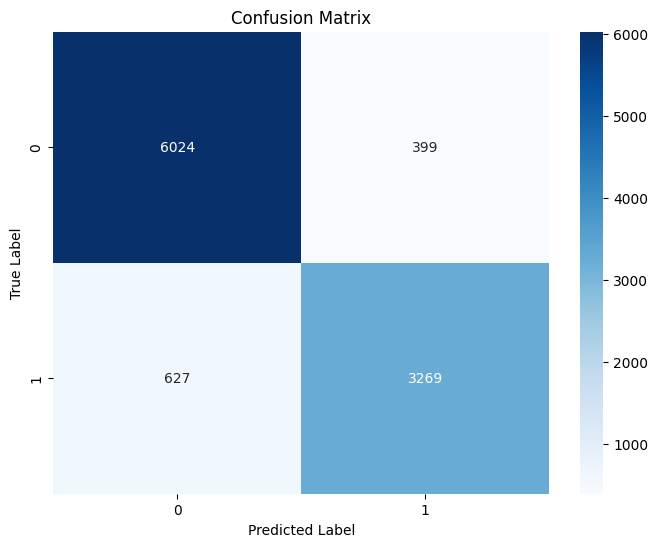

Classification Report:
              precision    recall  f1-score   support

           0     0.9057    0.9379    0.9215      6423
           1     0.8912    0.8391    0.8644      3896

    accuracy                         0.9006     10319
   macro avg     0.8985    0.8885    0.8929     10319
weighted avg     0.9003    0.9006    0.8999     10319

Macro Precision: 0.8985
Macro Recall: 0.8885
Macro F1 Score: 0.8929


In [ ]:
from sklearn.metrics import confusion_matrix, classification_report, precision_score, recall_score, f1_score
# Compute and print the confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:")
print(conf_matrix)

# Optional: Visualize the confusion matrix using a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

# Print the classification report
print("Classification Report:")
print(classification_report(y_test, y_pred, digits=4))

# Compute and print the macro precision, recall, and F1 score
precision = precision_score(y_test, y_pred, average='macro')
recall = recall_score(y_test, y_pred, average='macro')
f1 = f1_score(y_test, y_pred, average='macro')

print(f"Macro Precision: {precision:.4f}")
print(f"Macro Recall: {recall:.4f}")
print(f"Macro F1 Score: {f1:.4f}")

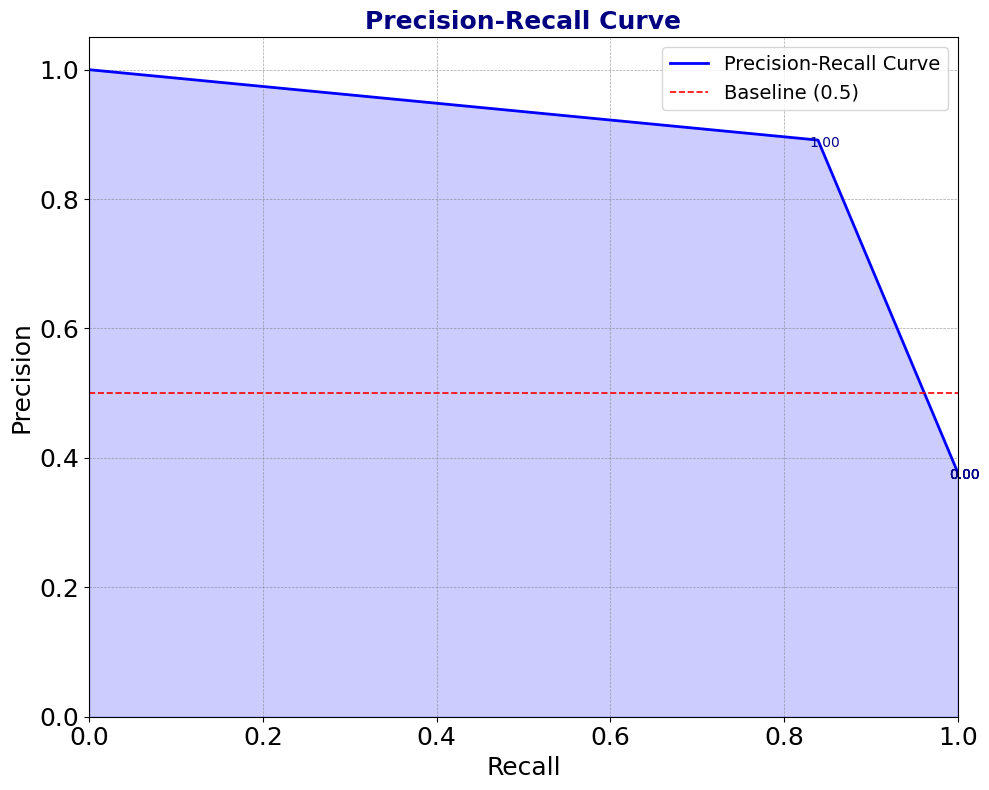

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import precision_recall_curve

# Assuming you have your true labels (y_test) and predicted probabilities (y_scores)
# If using a binary classifier, y_scores should be the predicted probabilities for the positive class

# Calculate precision and recall
precision, recall, thresholds = precision_recall_curve(y_test, y_pred)

# Plot setup
plt.figure(figsize=(10, 8))
plt.plot(recall, precision, color='blue', linewidth=2, label='Precision-Recall Curve')
plt.fill_between(recall, precision, color='blue', alpha=0.2)

# Adding aesthetics
plt.title('Precision-Recall Curve', fontsize=18, fontweight='bold', color='navy')
plt.xlabel('Recall', fontsize=18)
plt.ylabel('Precision', fontsize=18)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
plt.grid(color='gray', linestyle='--', linewidth=0.5, alpha=0.7)

# Adding a baseline line at y=0.5 for reference
plt.axhline(y=0.5, color='red', linestyle='--', label='Baseline (0.5)', linewidth=1.2)

# Annotate selected thresholds sparsely to avoid clutter
num_points = 5  # Number of thresholds to annotate
threshold_points = np.linspace(0, len(thresholds) - 1, num_points, dtype=int)
for i in threshold_points:
    plt.annotate(f'{thresholds[i]:.2f}',
                 xy=(recall[i], precision[i]),
                 textcoords="offset points", xytext=(5, -5),
                 ha='center', fontsize=10, color='darkblue')

# Adding legend
plt.legend(fontsize=14, loc='upper right')
plt.tight_layout()
plt.show()


In [ ]:
# Inverse transform the scaled test features
time_features_unscaled = time_scaler.inverse_transform(X_test[:, -1, :len(time_features)])
sensor_features_unscaled = sensor_scaler.inverse_transform(X_test[:, -1, len(time_features):])

# Extract job_id, priority_id, y_test_actual, and y_test_pred for the last row in each sliding window
job_ids_last = job_ids_test[:, -1]  # Extract the last job_id in each window
priority_ids_last = priority_ids_test[:, -1]  # Extract the last priority_id in each window
y_test_actual_last = y_test  # The actual test labels already represent the last label in each window

# Ensure that the job_ids_last, priority_ids_last, y_test_actual_last, and y_test_pred are 1D arrays
job_ids_last = np.array(job_ids_last).flatten()  # Flatten to 1D
priority_ids_last = np.array(priority_ids_last).flatten()  # Flatten to 1D
y_test_actual_last = np.array(y_test_actual_last).flatten()  # Flatten to 1D
y_test_pred = np.array(y_pred).flatten()  # Flatten to 1D

# Create a dictionary to form a DataFrame
df_data = {
    'job_id': job_ids_last,
    'priority_id': priority_ids_last,
    'y_test_actual': y_test_actual_last,
    'y_test_pred': y_pred
}

# Combine unscaled features into a DataFrame
time_features_df = pd.DataFrame(time_features_unscaled, columns=time_features)
sensor_features_df = pd.DataFrame(sensor_features_unscaled, columns=sensor_features)

# Extract job_id, priority_id, y_test_actual, and y_test_pred for the last row in each sliding window
job_ids_last = job_ids_test[:, -1].flatten()  # Convert 2D array to 1D by taking the last job_id in each window
priority_ids_last = priority_ids_test[:, -1].flatten()  # Convert 2D array to 1D by taking the last priority_id in each window
y_test_actual_last = y_test.flatten()  # Ensure y_test_actual is 1D
y_test_pred = y_pred.flatten()  # Ensure predictions are 1D



In [ ]:
print(y_test_pred.shape)

(10319,)


In [ ]:
print(time_features_df.shape)

(10319, 5)


In [ ]:
print(sensor_features_df.shape)

In [ ]:
print(df_data)

In [ ]:
df_data['y_test_pred'] = np.ravel(df_data['y_test_pred'])

In [ ]:
df = pd.DataFrame(df_data)

In [ ]:
print(df.head)

<bound method NDFrame.head of         job_id priority_id  y_test_actual  y_test_pred
0            0          NL              0            0
1            0          NL              0            0
2      8169737         3.0              1            1
3            0          NL              0            1
4      8362874         3.0              1            1
...        ...         ...            ...          ...
10314  8320074         3.0              1            0
10315        0          NL              0            0
10316        0          NL              0            0
10317  8309149         3.0              1            1
10318        0          NL              0            0

[10319 rows x 4 columns]>


In [ ]:
# Combine everything into a single DataFrame
df_representative = pd.concat([time_features_df, sensor_features_df, df], axis=1)

# Display the resulting DataFrame
print(df_representative.head())

     year  month   day  hour  minute    WMS0117  WMS0103.A3_F  WMS0103.A3_P  \
0  2023.0    6.0  17.0   6.0    20.0  91.482993      9.361809     95.852851   
1  2023.0   12.0  11.0  18.0     0.0  89.753692     27.288864     94.060278   
2  2023.0    7.0  19.0  18.0    25.0  89.693717     25.430330     93.492630   
3  2024.0    2.0   7.0  16.0    55.0  90.023583     28.918861     94.498462   
4  2024.0    2.0  14.0   4.0    45.0  91.403025     16.082762     95.633758   

   WMS0104.A3_F  WMS0104.A3_P  WMS0116.A3_F  WMS0116.A3_P  WBS628.A3_F  \
0      4.811759     58.159028      1.389477     56.914186       4.0000   
1     11.715552     56.336579      5.033184     55.529922      16.3125   
2     18.818792     56.585548      5.327893     55.031985      22.0625   
3     12.257251     56.695094      5.330586     55.908354      13.3750   
4      6.609709     58.009647      4.046508     57.143237      12.8750   

   WBS628.A3_P1  WBS628.A3_P2  DMA_Formula   job_id priority_id  \
0     97.0781

In [ ]:
# Convert the time features to a single DateTime column
df_representative['DateTime'] = pd.to_datetime({
    'year': df_representative['year'].astype(int),
    'month': df_representative['month'].astype(int),
    'day': df_representative['day'].astype(int),
    'hour': df_representative['hour'].astype(int),
    'minute': df_representative['minute'].astype(int)
})

# Sort the dataframe in ascending order by the DateTime column
df_representative_sorted = df_representative.sort_values(by='DateTime').reset_index(drop=True)

# Drop the 'col2' column
#df_representative_sorted = df_representative_sorted.drop(columns=['time'])
# Display the sorted dataframe
print(df_representative_sorted)

         year  month   day  hour  minute    WMS0117  WMS0103.A3_F  \
0      2023.0    4.0   1.0   1.0    50.0  91.463001      9.664539   
1      2023.0    4.0   1.0   2.0    20.0  91.512981      9.974173   
2      2023.0    4.0   1.0   2.0    45.0  91.293070      9.791771   
3      2023.0    4.0   1.0   3.0     0.0  91.163122      9.411448   
4      2023.0    4.0   1.0   4.0    25.0  92.022774      7.628613   
...       ...    ...   ...   ...     ...        ...           ...   
10314  2024.0    2.0  29.0  20.0    15.0  90.483397     43.169571   
10315  2024.0    2.0  29.0  21.0    45.0  91.133134     32.160000   
10316  2024.0    2.0  29.0  22.0     0.0  92.382629     28.288982   
10317  2024.0    2.0  29.0  23.0     5.0  92.742483     23.657499   
10318  2024.0    2.0  29.0  23.0    55.0  93.202297     20.122990   

       WMS0103.A3_P  WMS0104.A3_F  WMS0104.A3_P  ...  WMS0116.A3_P  \
0         95.544130      9.955671     58.159028  ...     57.053608   
1         95.803057      8.6790

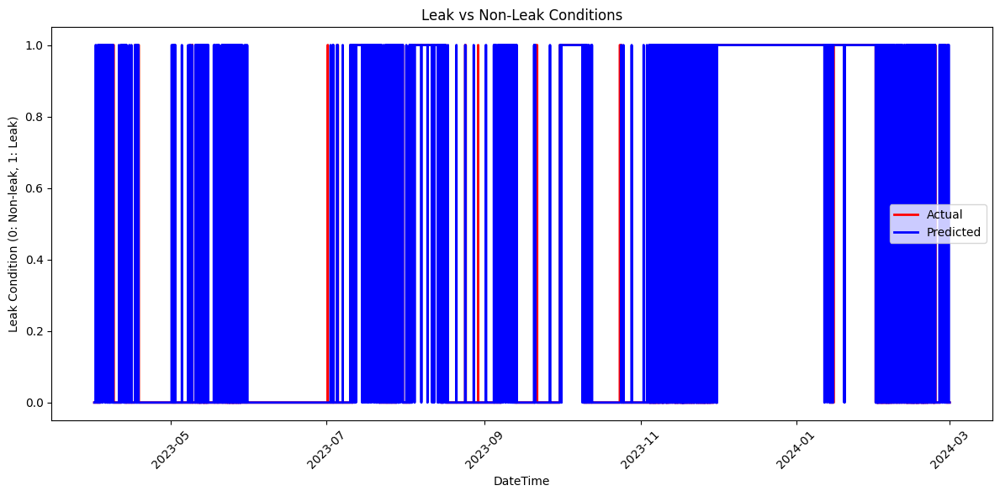

In [ ]:
# Set the figure size for the plot
plt.figure(figsize=(12, 6))

# Plot the actual leak conditions using a step plot
plt.step(df_representative_sorted['DateTime'], df_representative_sorted['y_test_actual'],
         label='Actual', color='red', linewidth=2, where='mid')

# Plot the predicted leak conditions using a step plot
plt.step(df_representative_sorted['DateTime'], df_representative_sorted['y_test_pred'],
         label='Predicted', color='blue', linewidth=2, where='mid')

# Set plot title and labels
plt.title("Leak vs Non-Leak Conditions")
plt.xlabel("DateTime")
plt.ylabel("Leak Condition (0: Non-leak, 1: Leak)")

# Display the legend
plt.legend()

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Show the plot
plt.tight_layout()
plt.show()


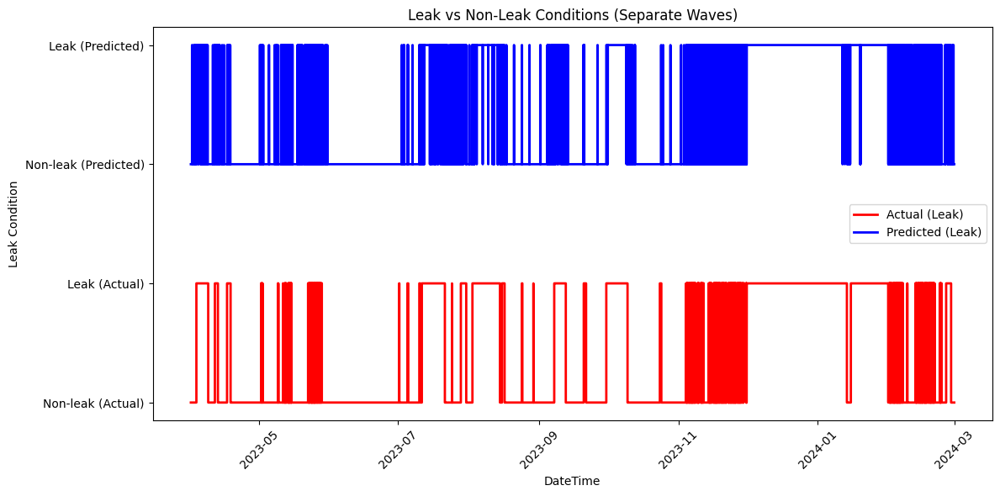

In [ ]:
import matplotlib.pyplot as plt

# Set the figure size for the plot
plt.figure(figsize=(12, 6))

# Larger offset to completely separate the waves
offset = 2

# Plot the actual leak conditions using a step plot (no offset)
plt.step(df_representative_sorted['DateTime'], df_representative_sorted['y_test_actual'],
         label='Actual (Leak)', color='red', linewidth=2, where='mid')

# Plot the predicted leak conditions using a step plot (with larger offset)
plt.step(df_representative_sorted['DateTime'], df_representative_sorted['y_test_pred'] + offset,
         label='Predicted (Leak)', color='blue', linewidth=2, where='mid')

# Set plot title and labels
plt.title("Leak vs Non-Leak Conditions (Separate Waves)")
plt.xlabel("DateTime")
plt.ylabel("Leak Condition")

# Add legend
plt.legend()

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Set custom y-ticks to differentiate actual and predicted
plt.yticks([0, 1, 2, 3], ['Non-leak (Actual)', 'Leak (Actual)', 'Non-leak (Predicted)', 'Leak (Predicted)'])

# Show the plot
plt.tight_layout()
plt.show()


In [ ]:
# Create a DataFrame to store the data similar to results_df
results_df = pd.DataFrame({
    'job_id': df_representative['job_id'],
    'priority_id': df_representative['priority_id'],
    'y_test_actual': df_representative['y_test_actual'],
    'y_test_pred': df_representative['y_test_pred']
})

# Display the DataFrame
print("Results DataFrame:")
print(results_df.head())

Results DataFrame:
    job_id priority_id  y_test_actual  y_test_pred
0        0          NL              0            0
1        0          NL              0            0
2  8169737         3.0              1            1
3        0          NL              0            1
4  8362874         3.0              1            1


In [ ]:
# Filter the DataFrame to get rows where job_id is not 0
results_df_non_zero = results_df[results_df['job_id'] != 0]

# Print the filtered DataFrame
print("Filtered DataFrame (job_id != 0):")
print(results_df_non_zero)

Filtered DataFrame (job_id != 0):
        job_id priority_id  y_test_actual  y_test_pred
2      8169737         3.0              1            1
4      8362874         3.0              1            1
6      8348088         3.0              1            1
8      8309149         3.0              1            1
9      8194914         3.0              1            1
...        ...         ...            ...          ...
10308  8201945         3.0              1            1
10310  8318250         3.0              1            1
10311  8249945         3.0              1            1
10314  8320074         3.0              1            0
10317  8309149         3.0              1            1

[3896 rows x 4 columns]


In [ ]:
# Get unique job IDs
result_unique_job_ids = results_df['job_id'].unique()
print("Unique job IDs:")
print(result_unique_job_ids)

Unique job IDs:
[      0 8169737 8362874 8348088 8309149 8194914 8320074 8111332 8330748
 8325264 8201945 8156945 8231996 8092648 8318250 8082462 8249945 8367926
 8284261 8339041 8150875 8088170 8300437 8084696 8367222 8208781 8217163
 8178938 8365877 8191058 8341442 8315970 8379439 8168728 8243436 8391608
 8347859 8234575 8314397 8358110 8287604 8137021 8084826 8403207 8304966
 8272312 8409148 8106850 8352598 8165583 8159350 8109232 8163187 8359922
 8304950 8344508 8309187 8223333 8345730 8195038 8333566 8343471 8128832
 8326617]


In [ ]:
print(len(result_unique_job_ids)-1) #subtract non-leak

63


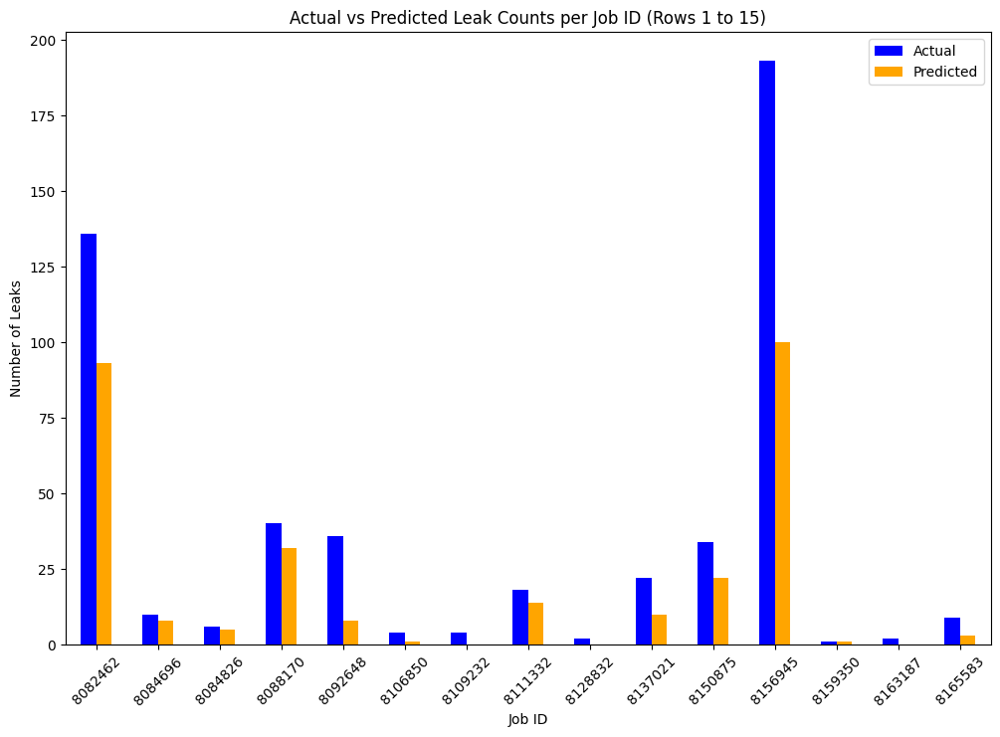

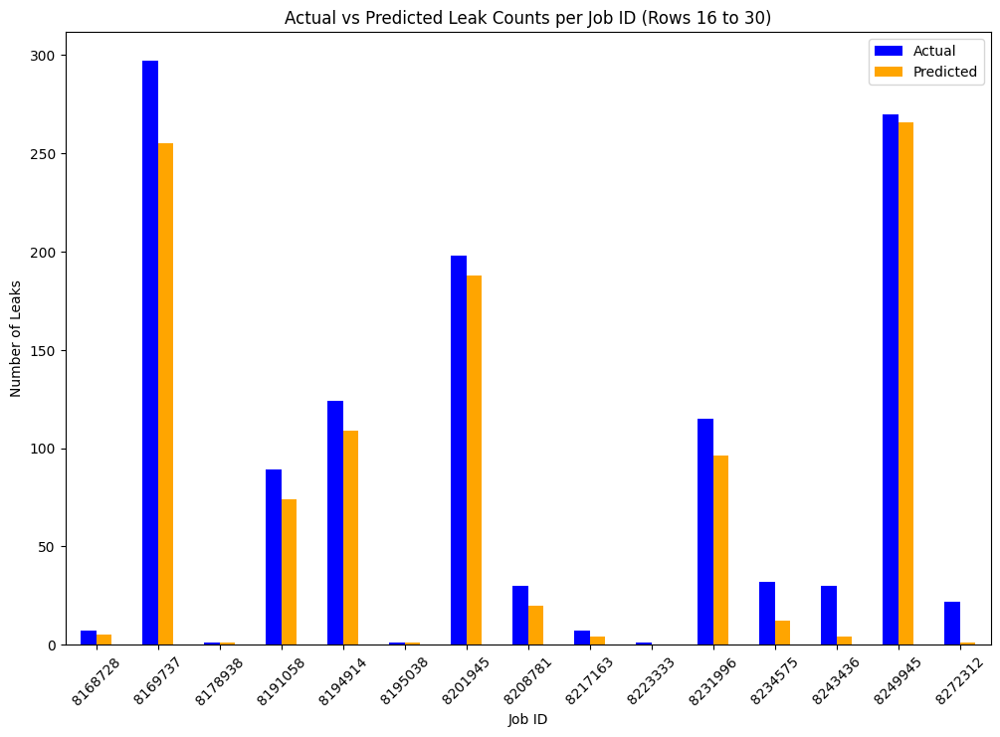

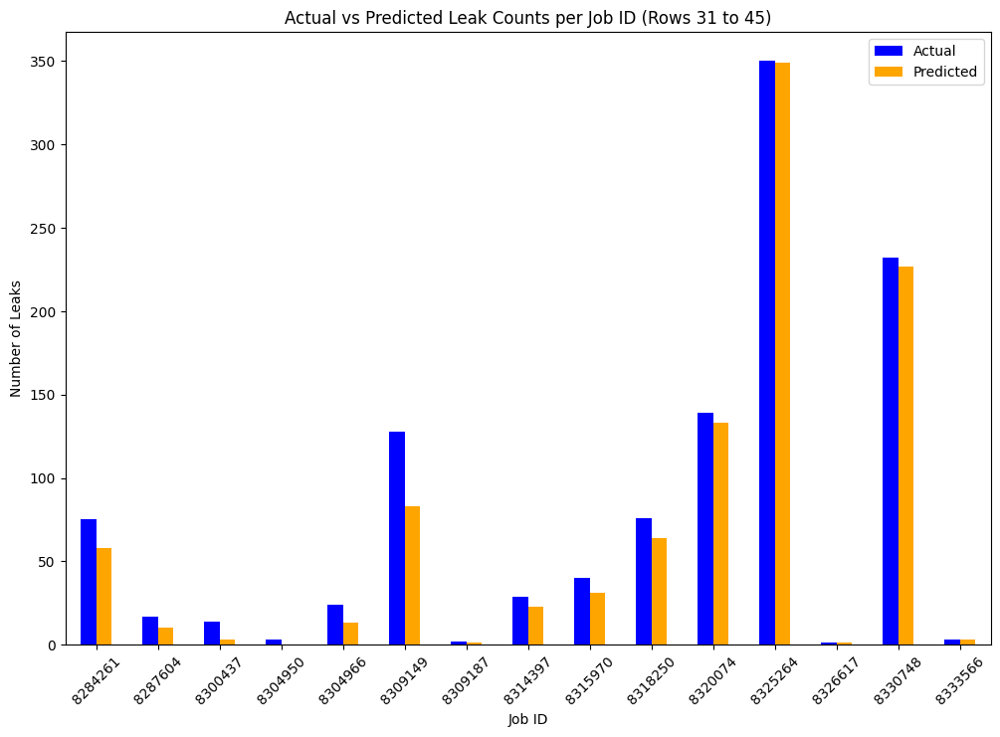

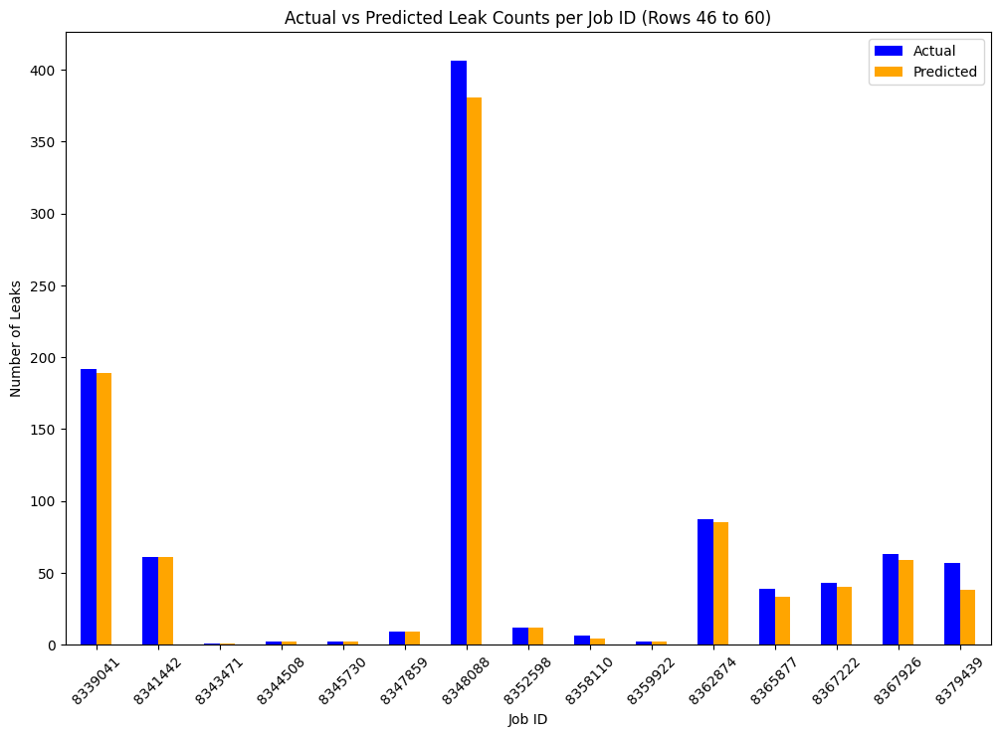

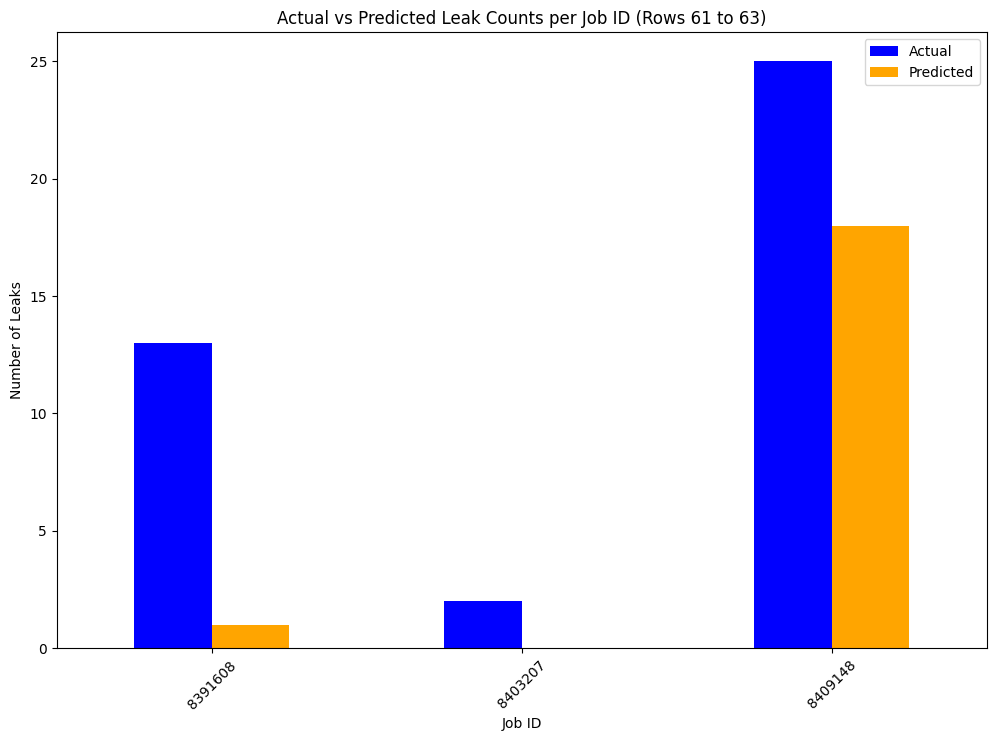

In [ ]:

# Filter out non-leak scenarios
leak_results_df = results_df[results_df['job_id'] != 0]

# Count of actual and predicted leaks per job_id
job_id_leak_counts = leak_results_df.groupby('job_id').agg({
    'y_test_actual': 'sum',
    'y_test_pred': 'sum'
}).reset_index()

# Determine the number of rows and the number of charts needed
total_rows = len(job_id_leak_counts)
rows_per_chart = 15
num_charts = (total_rows + rows_per_chart - 1) // rows_per_chart  # Calculate the number of charts

# Loop through the data and create charts
for i in range(num_charts):
    start = i * rows_per_chart
    end = min(start + rows_per_chart, total_rows)
    subset = job_id_leak_counts.iloc[start:end]

    # Plot bar chart
    plt.figure(figsize=(12, 8))
    subset.plot(kind='bar', x='job_id', stacked=False, color=['blue', 'orange'], ax=plt.gca())
    plt.title(f'Actual vs Predicted Leak Counts per Job ID (Rows {start+1} to {end})')
    plt.xlabel('Job ID')
    plt.ylabel('Number of Leaks')
    plt.xticks(rotation=45)
    plt.legend(['Actual', 'Predicted'])
    plt.show()


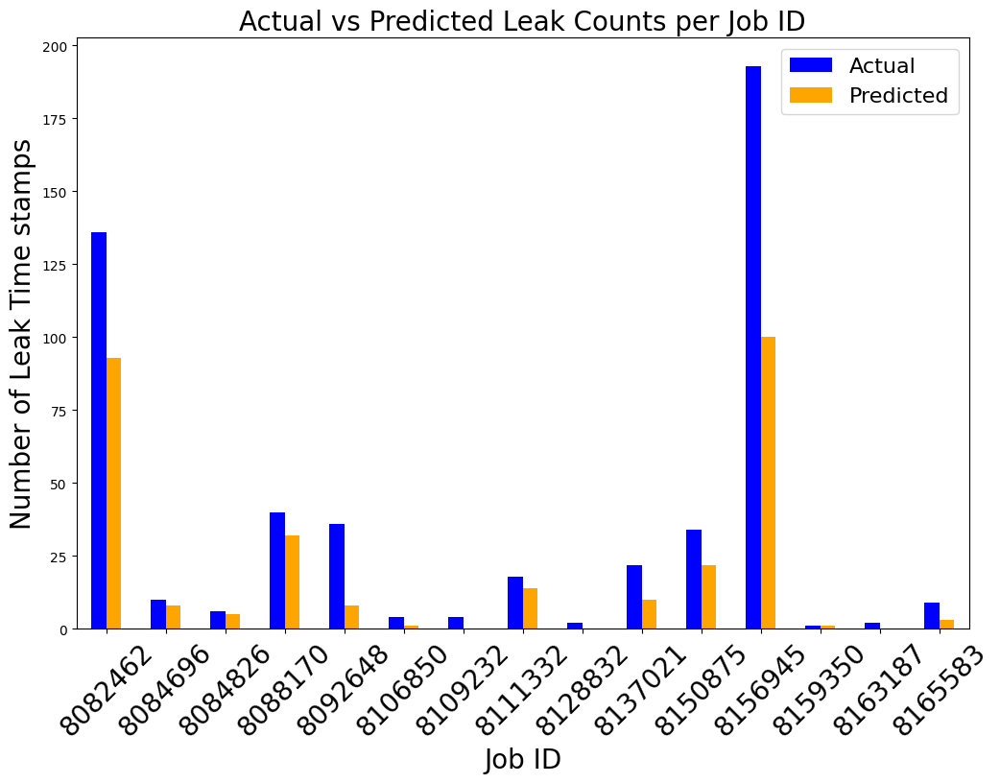

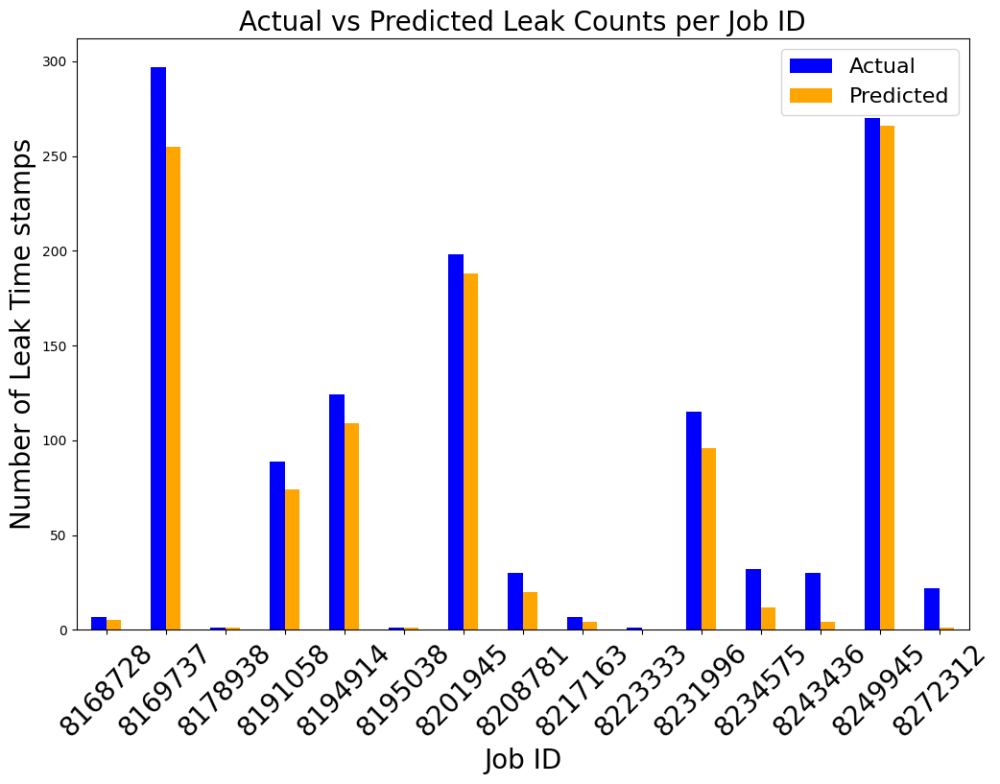

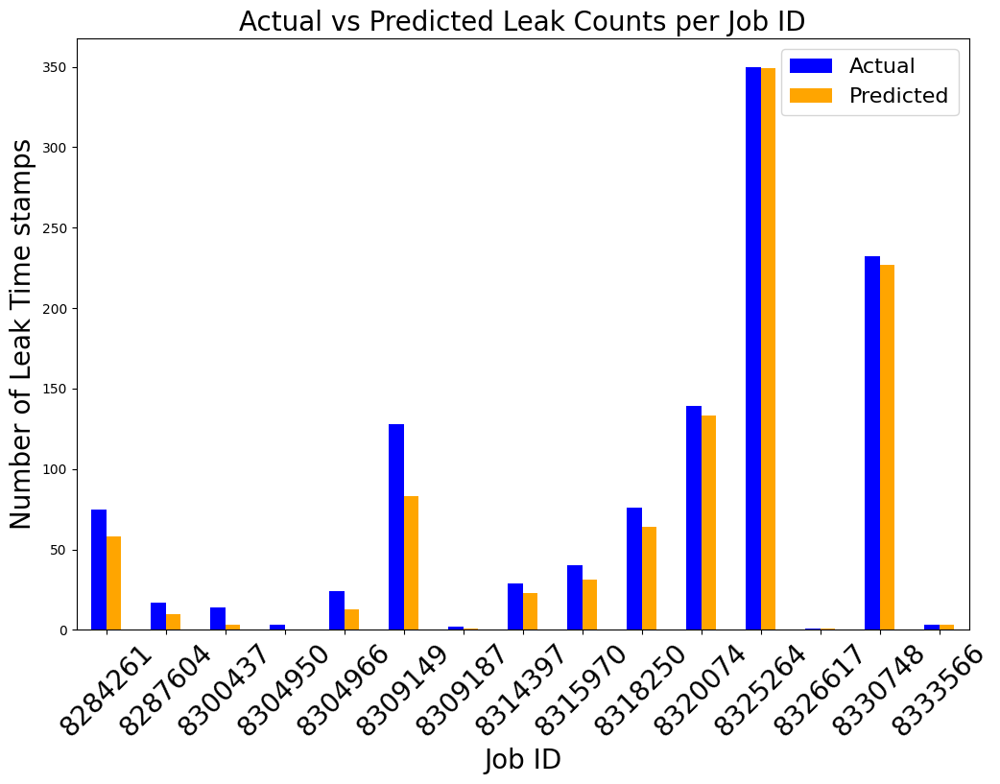

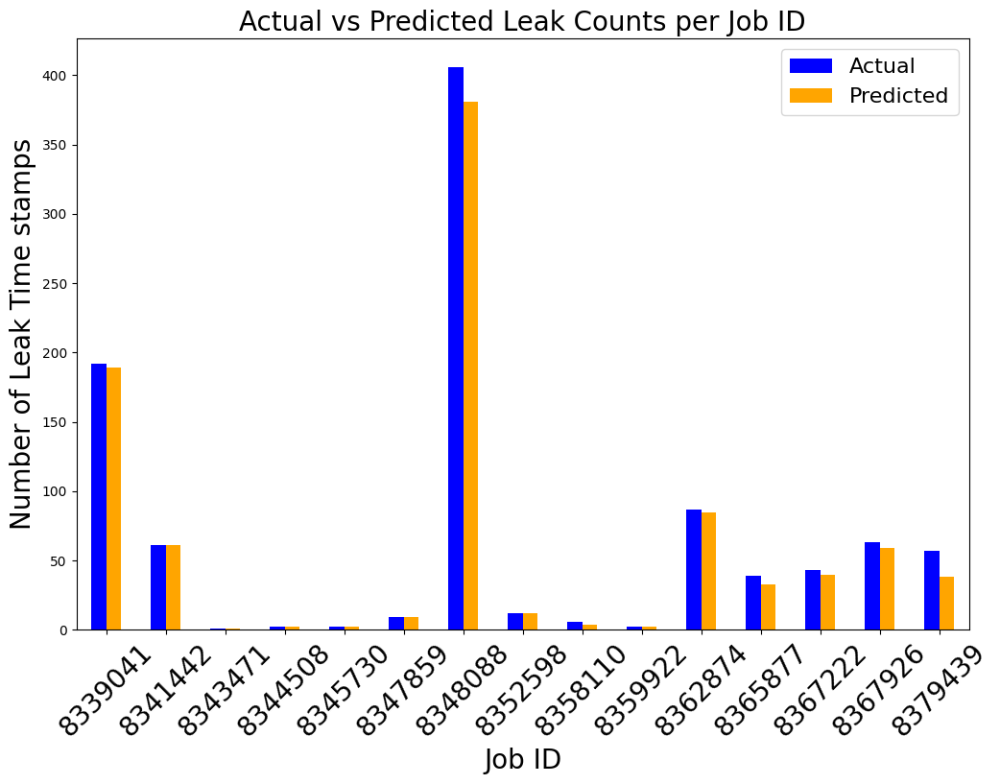

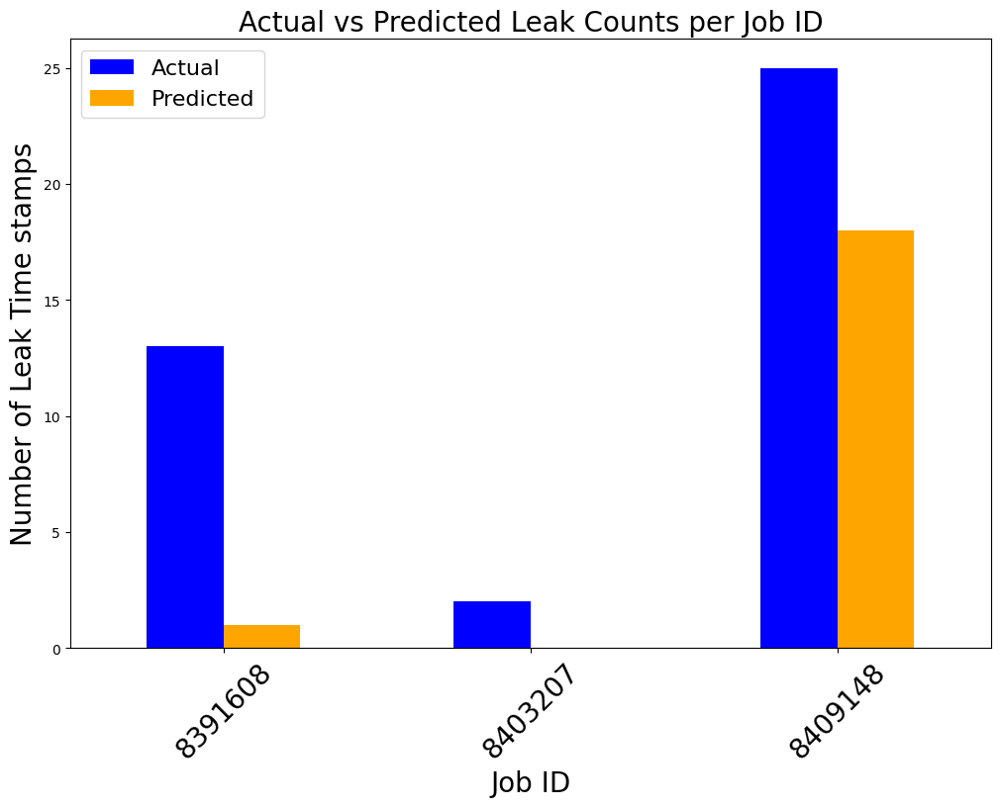

In [ ]:
import matplotlib.pyplot as plt

# Filter out non-leak scenarios
leak_results_df = results_df[results_df['job_id'] != 0]

# Count of actual and predicted leaks per job_id
job_id_leak_counts = leak_results_df.groupby('job_id').agg({
    'y_test_actual': 'sum',
    'y_test_pred': 'sum'
}).reset_index()

# Determine the number of rows and the number of charts needed
total_rows = len(job_id_leak_counts)
rows_per_chart = 15
num_charts = (total_rows + rows_per_chart - 1) // rows_per_chart  # Calculate the number of charts

# Loop through the data and create charts
for i in range(num_charts):
    start = i * rows_per_chart
    end = min(start + rows_per_chart, total_rows)
    subset = job_id_leak_counts.iloc[start:end]

    # Plot bar chart
    plt.figure(figsize=(12, 8))
    subset.plot(kind='bar', x='job_id', stacked=False, color=['blue', 'orange'], ax=plt.gca())

    # Set title and labels with increased font size
    plt.title(f'Actual vs Predicted Leak Counts per Job ID', fontsize=20)
    plt.xlabel('Job ID', fontsize=20)
    plt.ylabel('Number of Leak Time stamps', fontsize=20)
    plt.xticks(rotation=45, fontsize=20)

    # Set legend with increased font size
    plt.legend(['Actual', 'Predicted'], fontsize=16)

    plt.show()


In [ ]:
# Group by priority_id
grouped_by_priority = leak_results_df.groupby('priority_id')

# Initialize a dictionary to store counts
leak_counts = {}
correct_predictions_counts = {}

for priority, group in grouped_by_priority:
    total_leaks = len(group)
    correct_predictions = (group['y_test_actual'] == group['y_test_pred'].values.flatten()).sum()

    leak_counts[priority] = total_leaks
    correct_predictions_counts[priority] = correct_predictions


# Create a DataFrame for plotting
counts_df = pd.DataFrame({
    'priority_id': list(leak_counts.keys()),
    'Total_Leaks': list(leak_counts.values()),
    'Correct_Predictions': list(correct_predictions_counts.values())
})

# Calculate incorrect predictions
counts_df['Incorrect_Predictions'] = counts_df['Total_Leaks'] - counts_df['Correct_Predictions']


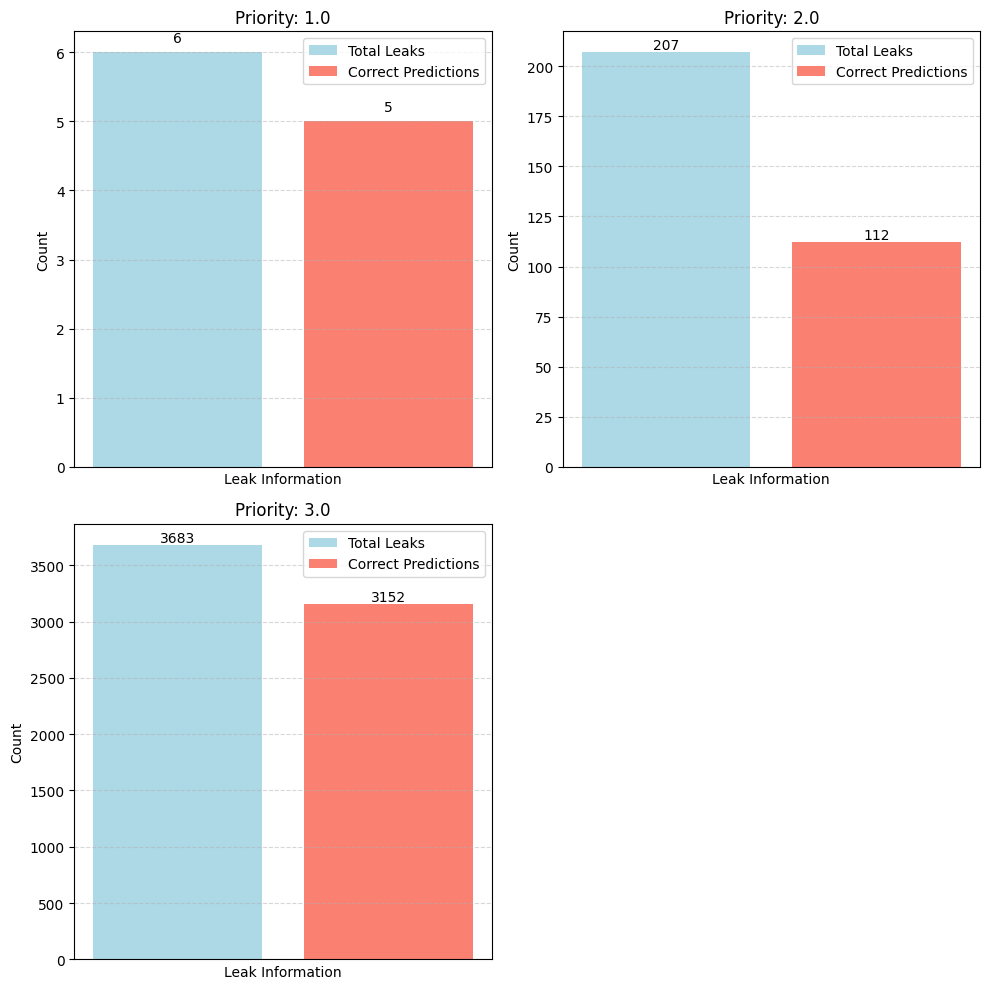

In [ ]:

# Create a DataFrame for plotting
counts_df = pd.DataFrame({
    'priority_id': list(leak_counts.keys()),
    'Total_Leaks': list(leak_counts.values()),
    'Correct_Predictions': list(correct_predictions_counts.values())
})

# Calculate incorrect predictions (optional)
counts_df['Incorrect_Predictions'] = counts_df['Total_Leaks'] - counts_df['Correct_Predictions']

# Set up the matplotlib figure
num_priorities = len(counts_df)
cols = 2  # Number of columns in the subplot grid
rows = (num_priorities + cols - 1) // cols  # Calculate number of rows needed

plt.figure(figsize=(10,10))

for i, row in counts_df.iterrows():
    plt.subplot(rows, cols, i + 1)
    priority = row['priority_id']

    # Create unique x values for each bar
    x_values = [0, 1]

    # Plot total leaks and correct predictions
    bars = plt.bar(x_values, [row['Total_Leaks'], row['Correct_Predictions']], color=['lightblue', 'salmon'], label=['Total Leaks', 'Correct Predictions'])

    # Add text labels for counts on top of bars with slight vertical offset
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, yval + 0.1, int(yval), ha='center', va='bottom')

    # Remove x-axis labels and ticks
    plt.xticks([])
    plt.xlabel('')

    # Add title and labels
    plt.title(f'Priority: {priority}')
    plt.ylabel('Count')
    plt.xlabel('Leak Information')
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.5)

# Adjust layout
plt.tight_layout()
plt.show()

In [ ]:
# Initialize dictionaries to store job counts
total_jobs = {}
correctly_predicted_jobs = {}

# Group by priority_id
grouped_by_priority = leak_results_df.groupby('priority_id')

for priority, group in grouped_by_priority:
    # Number of unique job_ids
    unique_jobs = group['job_id'].nunique()

    # Number of unique job_ids with at least one correct prediction
    jobs_with_correct_predictions = group[group['y_test_actual'] == group['y_test_pred'].values.flatten()]['job_id'].nunique()

    total_jobs[priority] = unique_jobs
    correctly_predicted_jobs[priority] = jobs_with_correct_predictions

# Create a DataFrame for plotting
jobs_df = pd.DataFrame({
    'priority_id': list(total_jobs.keys()),
    'Total_Jobs': list(total_jobs.values()),
    'Correctly_Predicted_Jobs': list(correctly_predicted_jobs.values())
})

# Set up the matplotlib figure
num_priorities = len(jobs_df)
cols = 2  # Number of columns in the subplot grid
rows = (num_priorities + cols - 1) // cols  # Calculate number of rows needed

plt.figure(figsize=(10,10))

for i, row in jobs_df.iterrows():
    plt.subplot(rows, cols, i + 1)
    priority = row['priority_id']

    # Plot total jobs and correctly predicted jobs
    bars = plt.bar(['Total Jobs', 'Correctly Predicted Jobs'], [row['Total_Jobs'], row['Correctly_Predicted_Jobs']],
                   color=['lightblue', 'salmon'])

    # Add count labels on top of bars
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), va='bottom')  # va: vertical alignment

    # Add title and labels
    plt.title(f'Priority: {priority}')
    plt.xlabel('Job Count Type')
    plt.ylabel('Number of Jobs')
    plt.grid(True, linestyle='--', alpha=0.7)

# Adjust layout
plt.tight_layout()
plt.show()


NameError: name 'leak_results_df' is not defined

In [ ]:
# Filter for job_ids where the predicted count is 0
zero_predicted_count = job_id_leak_counts[job_id_leak_counts['y_test_pred'] == 0]

# Number of job_ids with predicted count 0
num_zero_predicted_count = len(zero_predicted_count)

# List of job_ids with predicted count 0
job_ids_with_zero_predicted_count = zero_predicted_count['job_id'].tolist()

# Print the results
print(f"Number of job_ids with predicted count 0: {num_zero_predicted_count}")
print(f"job_ids with predicted count 0: {job_ids_with_zero_predicted_count}")


In [ ]:
# Total number of job_ids present
total_job_ids = len(job_id_leak_counts)

# Number of job_ids with predicted count > 0
num_predicted_job_ids = len(job_id_leak_counts[job_id_leak_counts['y_test_pred'] > 0])

# Number of job_ids with predicted count = 0
num_zero_predicted_count = len(job_id_leak_counts[job_id_leak_counts['y_test_pred'] == 0])

# Data for the bar chart
categories = ['Total Jobs', 'Predicted', 'Not Predicted']
counts = [total_job_ids, num_predicted_job_ids, num_zero_predicted_count]

# Plotting the bar chart
plt.figure(figsize=(8, 6))
bars = plt.bar(categories, counts, color=['blue', 'green', 'red'])

# Adding numbers on top of each bar
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.5, int(yval), ha='center', va='bottom')

plt.title('Summary of Job Predictions')
plt.xlabel('Category')
plt.ylabel('Number of Jobs')
plt.show()


In [ ]:
# Filter out non-leak scenarios
non_leak_results_df = results_df[results_df['job_id'] == 0]

In [ ]:
print(non_leak_results_df)

       job_id priority_id  y_test_actual  y_test_pred
0           0          NL              0            0
1           0          NL              0            0
3           0          NL              0            1
5           0          NL              0            0
7           0          NL              0            0
...       ...         ...            ...          ...
10312       0          NL              0            0
10313       0          NL              0            0
10315       0          NL              0            0
10316       0          NL              0            0
10318       0          NL              0            0

[6423 rows x 4 columns]


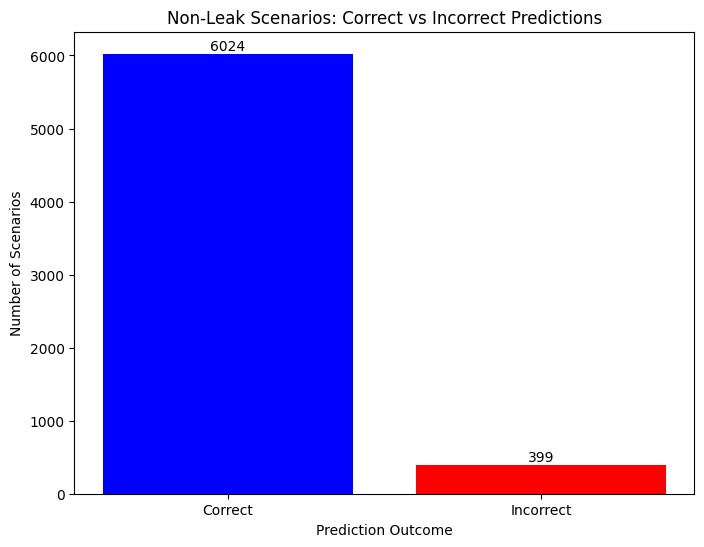

In [ ]:

# Assuming `non_leak_results_df` is already defined as you provided

# Calculate the number of correct and incorrect predictions
correct_predictions = non_leak_results_df[non_leak_results_df['y_test_actual'] == non_leak_results_df['y_test_pred']].shape[0]
incorrect_predictions = non_leak_results_df[non_leak_results_df['y_test_actual'] != non_leak_results_df['y_test_pred']].shape[0]

# Create a DataFrame for plotting
summary_df = pd.DataFrame({
    'Prediction': ['Correct', 'Incorrect'],
    'Count': [correct_predictions, incorrect_predictions]
})

# Plotting the bar chart
plt.figure(figsize=(8, 6))
plt.bar(summary_df['Prediction'], summary_df['Count'], color=['blue', 'red'])

# Adding labels and title
plt.xlabel('Prediction Outcome')
plt.ylabel('Number of Scenarios')
plt.title('Non-Leak Scenarios: Correct vs Incorrect Predictions')

# Display the numbers on the bars
for i in range(len(summary_df)):
    plt.text(i, summary_df['Count'][i] + 0.1, str(summary_df['Count'][i]), ha='center', va='bottom')

plt.show()


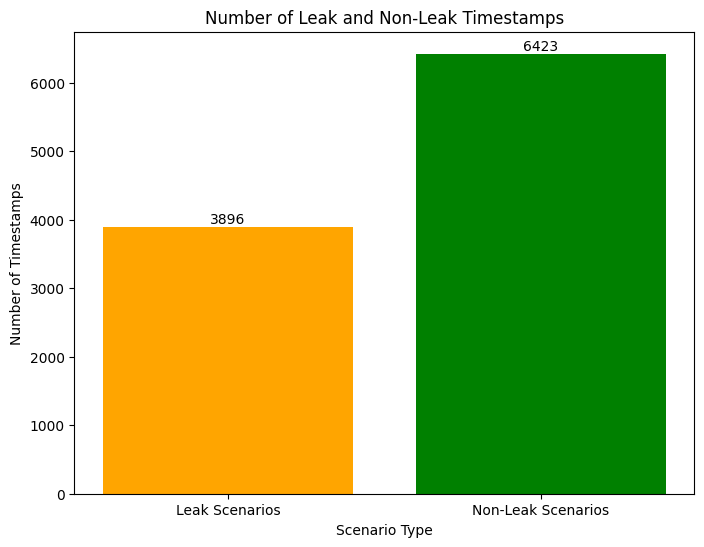

In [ ]:
# Assuming `results_df` is already defined and contains the columns: 'job_id', 'y_test_actual', 'y_test_pred'

# Count the number of leak and non-leak scenarios
leak_scenarios_count = results_df[results_df['job_id'] != 0].shape[0]
non_leak_scenarios_count = results_df[results_df['job_id'] == 0].shape[0]

# Create a DataFrame for plotting
scenarios_df = pd.DataFrame({
    'Scenario Type': ['Leak Scenarios', 'Non-Leak Scenarios'],
    'Count': [leak_scenarios_count, non_leak_scenarios_count]
})

# Plotting the bar chart
plt.figure(figsize=(8, 6))
plt.bar(scenarios_df['Scenario Type'], scenarios_df['Count'], color=['orange', 'green'])

# Adding labels and title
plt.xlabel('Scenario Type')
plt.ylabel('Number of Timestamps')
plt.title('Number of Leak and Non-Leak Timestamps')

# Display the numbers on the bars
for i in range(len(scenarios_df)):
    plt.text(i, scenarios_df['Count'][i] + 0.1, str(scenarios_df['Count'][i]), ha='center', va='bottom')

plt.show()


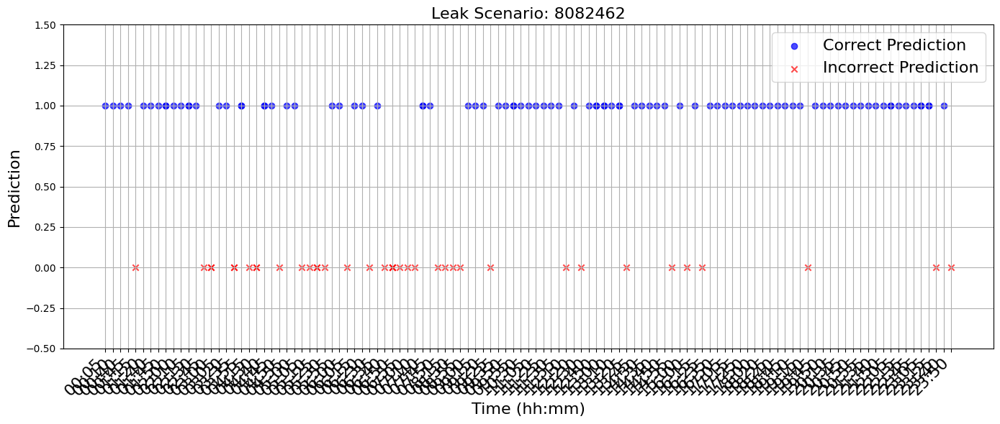

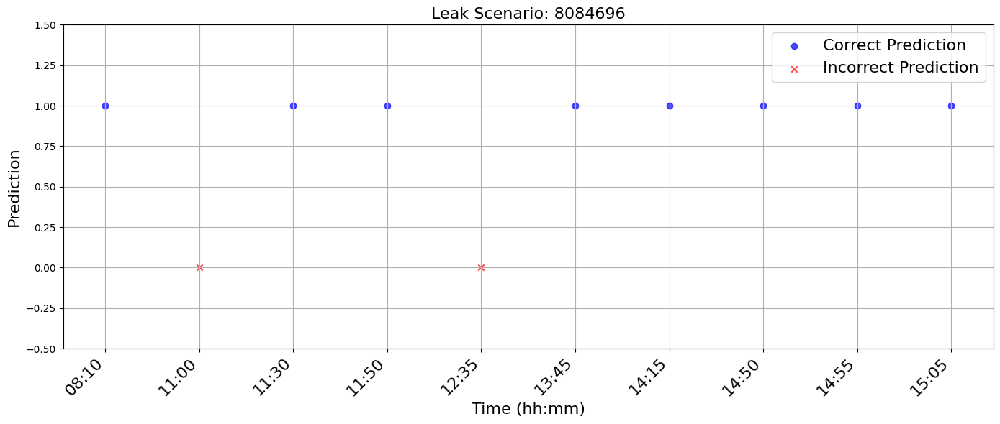

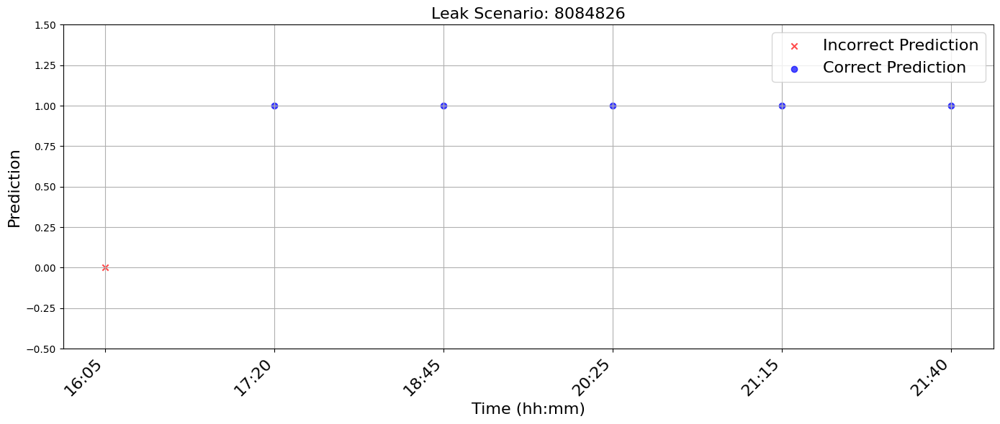

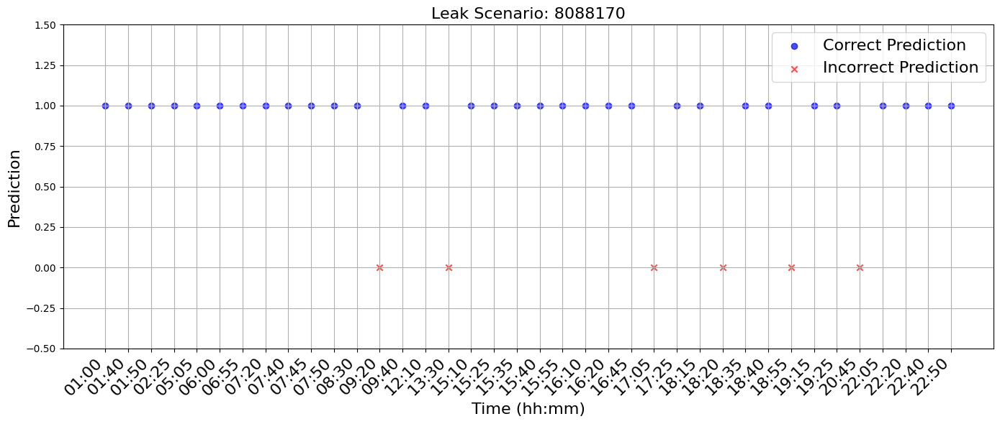

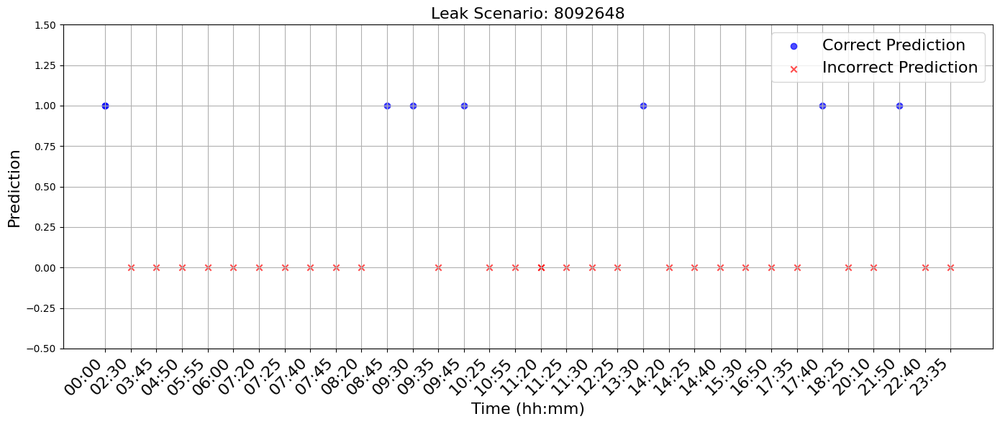

...

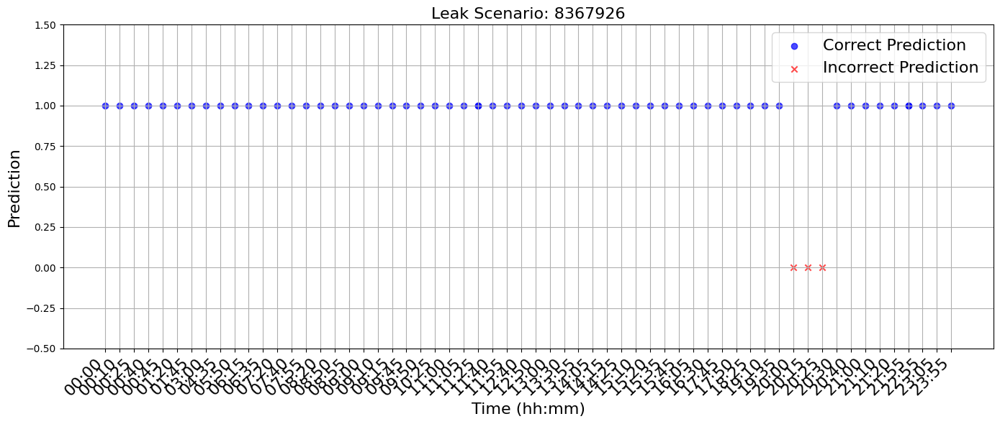

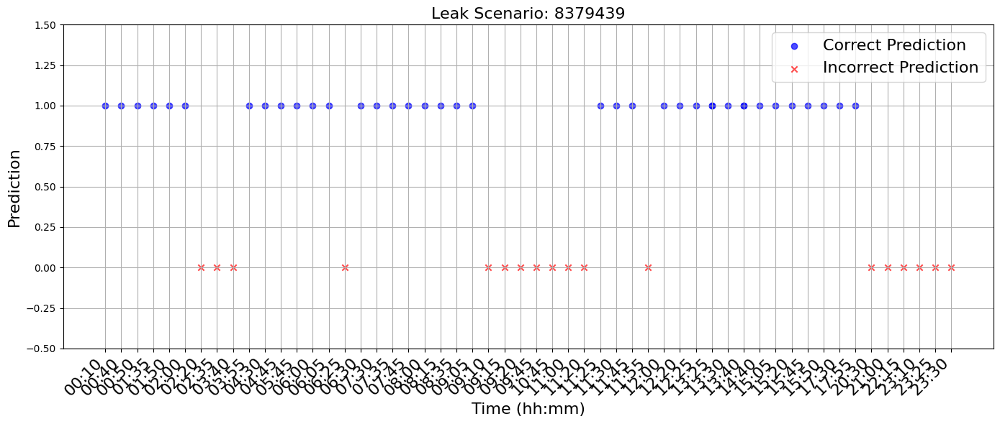

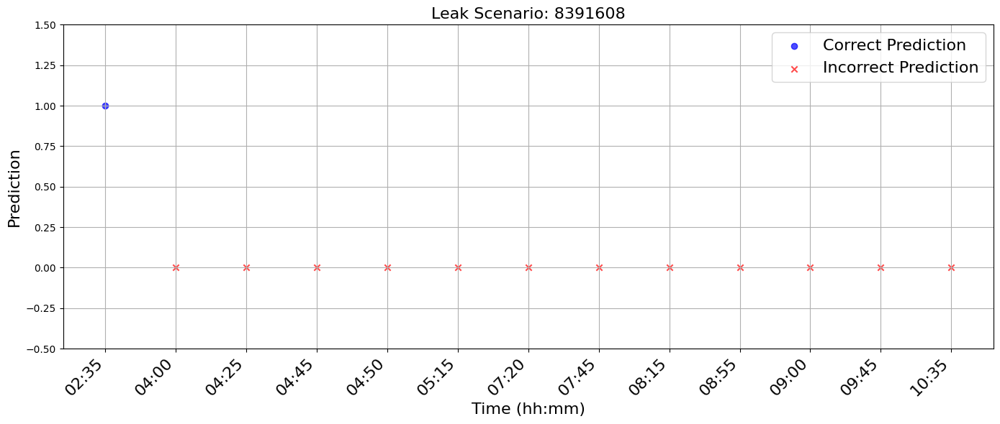

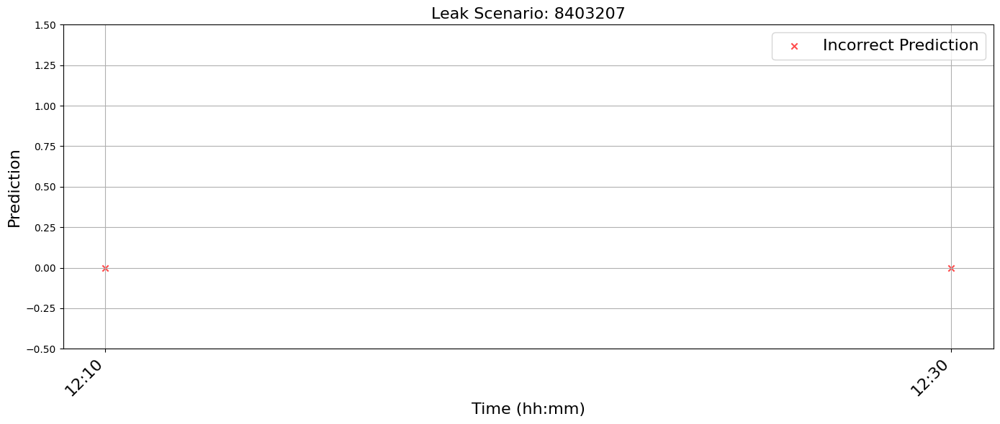

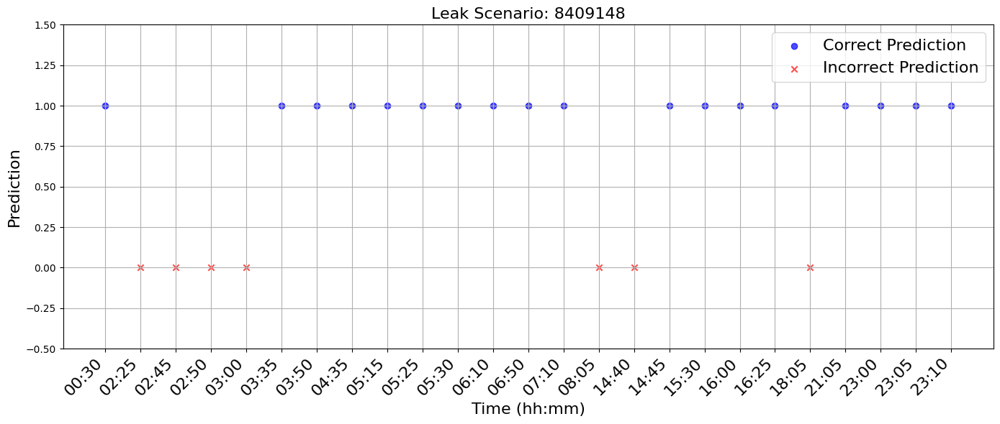

In [ ]:
# Convert hour and minute to integers
df_representative['hour'] = df_representative['hour'].astype(int)
df_representative['minute'] = df_representative['minute'].astype(int)

# Create the datetime column
df_representative['time'] = pd.to_datetime(df_representative[['hour', 'minute']].astype(str).agg(':'.join, axis=1), format='%H:%M')

# Filter out the non-leak scenarios (job_id = 0)
df_leak_scenarios = df_representative[df_representative['job_id'] != 0]

# Function to prioritize correct predictions
def prioritize_correct_predictions(group):
    # Check if there's a correct prediction in the group
    if 1 in group['y_test_pred'].values:
        # Retain only the correct predictions
        return group[group['y_test_pred'] == 1]
    # If no correct predictions, retain the incorrect ones
    return group

# Apply the prioritization function to the grouped data
df_prioritized = df_leak_scenarios.groupby(['time', 'job_id'], group_keys=False).apply(prioritize_correct_predictions)

# Plot each unique leak scenario
for job_id, group in df_prioritized.groupby('job_id'):
    # Combine all predictions for the current job_id and sort by time
    combined_df = group.copy()
    combined_df = combined_df.sort_values(by='time')

    plt.figure(figsize=(14, 6))  # Increase the width of the figure

    # Plot predictions
    for _, row in combined_df.iterrows():
        marker = 'o' if row['y_test_pred'] == 1 else 'x'
        color = 'blue' if row['y_test_pred'] == 1 else 'red'
        plt.scatter(row['time'].strftime('%H:%M'),
                    row['y_test_pred'],
                    c=color,
                    marker=marker,
                    label='Correct Prediction' if row['y_test_pred'] == 1 else 'Incorrect Prediction',
                    alpha=0.7)

    plt.xlabel('Time (hh:mm)',fontsize=16)
    plt.ylabel('Prediction',fontsize=16)
    plt.ylim(-0.5, 1.5)
    plt.title(f'Leak Scenario: {job_id}',fontsize=16)

    # Handle legend to avoid duplicate entries
    handles, labels = plt.gca().get_legend_handles_labels()
    by_label = dict(zip(labels, handles))
    plt.legend(by_label.values(), by_label.keys(),fontsize=16)

    plt.grid(True)

    # Rotate x-axis labels for better readability
    plt.xticks(rotation=45, ha='right',fontsize=16)

    plt.tight_layout()  # Adjust layout to make sure everything fits
    plt.show()

##TEST DATA

In [ ]:
!cp /content/drive/'My Drive'/YVW/test2.xlsx .

In [ ]:
# Read the data from an Excel file
test_data = pd.read_excel('test2.xlsx')

In [ ]:
print(test_data)

            Time and Date    WMS0117  WMS0103.A3_F  WMS0103.A3_P  \
0     2024-04-01 00:00:00  92.122734     17.503864     96.032108   
1     2024-04-01 00:05:00  92.242685     18.380453     96.530045   
2     2024-04-01 00:10:00  91.872835     19.226664     96.081901   
3     2024-04-01 00:15:00  91.522977     19.767204     96.211365   
4     2024-04-01 00:20:00  92.152722     17.908268     96.699343   
...                   ...        ...           ...           ...   
48380 2024-09-15 23:40:00  92.490000     12.400275     96.790000   
48381 2024-09-15 23:45:00  92.490000     11.933439     96.830000   
48382 2024-09-15 23:50:00  92.580000     12.419678     96.480000   
48383 2024-09-15 23:55:00  92.200000     11.772724     96.090000   
48384 2024-09-16 00:00:00  92.540000     11.300550           NaN   

       WMS0104.A3_F  WMS0104.A3_P  WMS0116.A3_F  WMS0116.A3_P  WBS628.A3_F  \
0          4.131948     59.095150      4.513322     57.720844       4.2500   
1          4.131948     59.

In [ ]:
print(test_data.dtypes)

Time and Date    datetime64[ns]
WMS0117                 float64
WMS0103.A3_F            float64
WMS0103.A3_P            float64
WMS0104.A3_F            float64
WMS0104.A3_P            float64
WMS0116.A3_F            float64
WMS0116.A3_P            float64
WBS628.A3_F             float64
WBS628.A3_P1            float64
WBS628.A3_P2            float64
dtype: object


In [ ]:
# Get rows with at least one NaN value
rows_with_nans = test_data[test_data.isnull().any(axis=1)]

# Display the rows
print(rows_with_nans)

      Time and Date  WMS0117  WMS0103.A3_F  WMS0103.A3_P  WMS0104.A3_F  \
48384    2024-09-16    92.54      11.30055           NaN      2.339776   

       WMS0104.A3_P  WMS0116.A3_F  WMS0116.A3_P  WBS628.A3_F  WBS628.A3_P1  \
48384          59.5      2.073481          57.4       2.5625         98.02   

       WBS628.A3_P2  
48384         51.81  


In [ ]:
# Assuming you have a DataFrame named 'df' and the column you want to fill is 'column_name'
test_data['WMS0103.A3_P'] = test_data['WMS0103.A3_P'].fillna(test_data['WMS0103.A3_P'].mean())

In [ ]:
# Split the "Time and Date" column
test_data['Time and Date'] = test_data['Time and Date'].astype(str)
test_data[['date', 'time']] = test_data['Time and Date'].str.split(' ', expand=True)
test_data[['year', 'month', 'day']] = test_data['date'].str.split('-', expand=True)

# Extract hour and minute from time
test_data[['hour', 'minute','seconds']] = test_data['time'].str.split(':', expand=True)

# Convert hour and minute to integers
test_data['hour'] = test_data['hour'].astype(int)
test_data['minute'] = test_data['minute'].astype(int)
test_data['month'] = test_data['month'].astype(int)

In [ ]:
test_data.drop(columns=['Time and Date', 'date', 'time', 'seconds'], inplace=True)

In [ ]:
# Define the formula as a lambda function for clarity
formula = lambda row: row['WMS0103.A3_F'] - 0 + row['WMS0104.A3_F'] + row['WMS0116.A3_F'] - row['WBS628.A3_F']

# Create the new column using the 'apply' method
test_data['DMA_Formula'] = test_data.apply(formula, axis=1)

In [ ]:
# Desired column order
new_order = ['year','month', 'day', 'hour','minute','WMS0117', 'WMS0103.A3_F','WMS0103.A3_P', 'WMS0104.A3_F','WMS0104.A3_P', 'WMS0116.A3_F','WMS0116.A3_P', 'WBS628.A3_F','WBS628.A3_P1','WBS628.A3_P2', 'DMA_Formula']

# Reorder columns
test_data = test_data[new_order]

In [ ]:
print(test_data)

In [ ]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

# Define the time features and sensor features
time_features = ['year', 'month', 'day', 'hour', 'minute']
sensor_features = ['WMS0117', 'WMS0103.A3_F','WMS0103.A3_P', 'WMS0104.A3_F','WMS0104.A3_P', 'WMS0116.A3_F','WMS0116.A3_P', 'WBS628.A3_F','WBS628.A3_P1','WBS628.A3_P2', 'DMA_Formula']

In [ ]:
# Apply scalers to respective columns
test_data[time_features] = time_scaler.fit_transform(test_data[time_features])
test_data[sensor_features] = sensor_scaler.fit_transform(test_data[sensor_features])

NameError: name 'time_scaler' is not defined

In [ ]:
# Assuming 'test_data' is your unseen data DataFrame
# Define the sliding window function
def create_sliding_window(df, window_size=20, step_size=1):
    X = []
    for start in range(0, len(df) - window_size + 1, step_size):
        end = start + window_size
        window = df.iloc[start:end]
        X.append(window.values)  # Take the feature values
    return np.array(X)

# Create sliding windows for test_data
X_test_unseen = create_sliding_window(test_data, window_size=20)

# Ensure the shape is correct for the RNN model
print(X_test_unseen.shape)  # Shape should be (samples, window_size, num_features)


(48366, 20, 16)


In [ ]:
from tensorflow.keras.models import load_model

# Replace the path with the actual path to your .h5 file
model_path = '/content/drive/My Drive/YVW/10values_job1_model.h5'
model = load_model(model_path)


In [ ]:
# Make predictions using the loaded model
predictions = model.predict(X_test_unseen)

# Convert predictions to binary class (0 or 1) if necessary
predicted_classes = (predictions > 0.5).astype(int)

# Display the predictions
print(predicted_classes)


1512/1512 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step
[[0]
 [0]
 [0]
 ...
 [1]
 [1]
 [1]]


In [ ]:
print(predictions.shape)

(48366, 1)


In [ ]:
import pandas as pd

# Get the indices of the last row of each window
window_size = 20  # Assuming the window size is 20
step_size = 1  # Assuming the step size is 1

# Get the rows that correspond to the end of each window
last_indices = [start + window_size - 1 for start in range(0, len(test_data) - window_size + 1, step_size)]

# Extract the corresponding rows from test_data
test_data_windowed = test_data.iloc[last_indices].reset_index(drop=True)

# Create a DataFrame for the predictions
predictions_df = pd.DataFrame(predicted_classes, columns=['label'])

# Combine the original test data and predictions
combined_df = pd.concat([test_data_windowed, predictions_df], axis=1)

# Unscale the time features using the inverse transform of the time scaler
combined_df[time_features] = time_scaler.inverse_transform(combined_df[time_features])

# Unscale the sensor features using the inverse transform of the sensor scaler
combined_df[sensor_features] = sensor_scaler.inverse_transform(combined_df[sensor_features])

# Display the resulting DataFrame with unscaled features
print(combined_df)


         year  month   day  hour  minute    WMS0117  WMS0103.A3_F  \
0      2024.0    4.0   1.0   1.0    35.0  92.172714     15.451935   
1      2024.0    4.0   1.0   1.0    40.0  92.662516     15.460766   
2      2024.0    4.0   1.0   1.0    45.0  92.172714     14.980043   
3      2024.0    4.0   1.0   1.0    50.0  92.602540     15.058350   
4      2024.0    4.0   1.0   1.0    55.0  92.022774     14.435589   
...       ...    ...   ...   ...     ...        ...           ...   
48361  2024.0    9.0  15.0  23.0    40.0  92.490000     12.400275   
48362  2024.0    9.0  15.0  23.0    45.0  92.490000     11.933439   
48363  2024.0    9.0  15.0  23.0    50.0  92.580000     12.419678   
48364  2024.0    9.0  15.0  23.0    55.0  92.200000     11.772724   
48365  2024.0    9.0  16.0   0.0     0.0  92.540000     11.300550   

       WMS0103.A3_P  WMS0104.A3_F  WMS0104.A3_P  WMS0116.A3_F  WMS0116.A3_P  \
0         96.460334      4.724577     59.254489      3.491629     58.149070   
1         96.

In [ ]:
# Assuming you already have the combined_df with the 'predicted_label' column
# Combine the year, month, day, hour, and minute columns into one datetime column
combined_df['datetime'] = pd.to_datetime(combined_df[['year', 'month', 'day', 'hour', 'minute']])

# Format the datetime as dd/mm/yyyy hh:mm
combined_df['formatted_datetime'] = combined_df['datetime'].dt.strftime('%d/%m/%Y %H:%M')

# Select the required columns: formatted datetime and predicted label
final_df = combined_df[['formatted_datetime', 'label']]

# Sort by datetime in ascending order
final_df = final_df.sort_values(by='formatted_datetime')

# Reset index after sorting
final_df.reset_index(drop=True, inplace=True)


In [ ]:
# Save the DataFrame to an Excel file in Google Drive
final_df.to_excel('/content/drive/My Drive/YVW/test2_job1_result.xlsx', index=False)

In [ ]:
print(final_df)

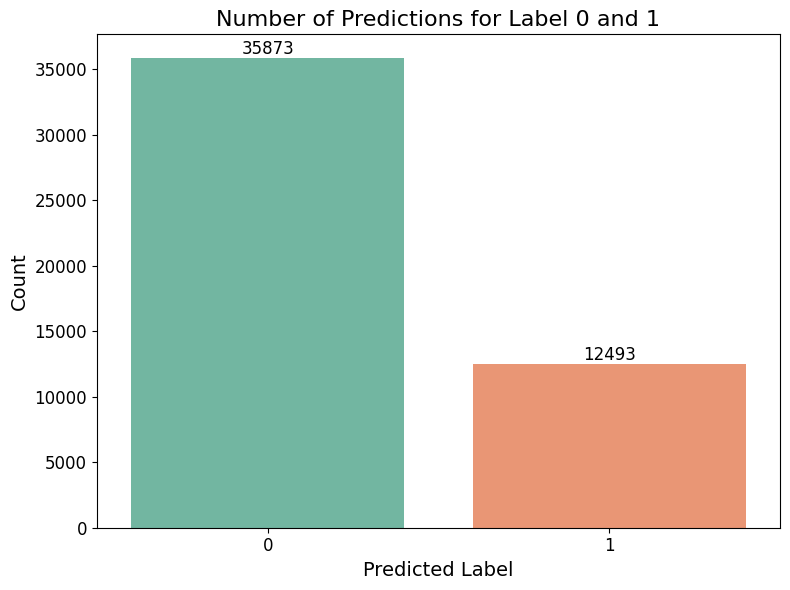

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Count the occurrences of each predicted label (0 and 1)
label_counts = final_df['label'].value_counts().sort_index()

# Create a bar plot
plt.figure(figsize=(8, 6))
ax = sns.barplot(x=label_counts.index, y=label_counts.values, palette="Set2")

# Add the count values on top of the bars
for i in range(len(label_counts)):
    ax.text(i, label_counts.values[i] + 0.1, str(label_counts.values[i]), ha='center', va='bottom', fontsize=12)

# Customize the plot
plt.title('Number of Predictions for Label 0 and 1', fontsize=16)
plt.xlabel('Predicted Label', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks([0, 1], ['0', '1'], fontsize=12)
plt.yticks(fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()


In [ ]:
print(final_df['label'].value_counts())

label
0    35873
1    12493
Name: count, dtype: int64


In [ ]:
final_df = final_df.drop_duplicates()

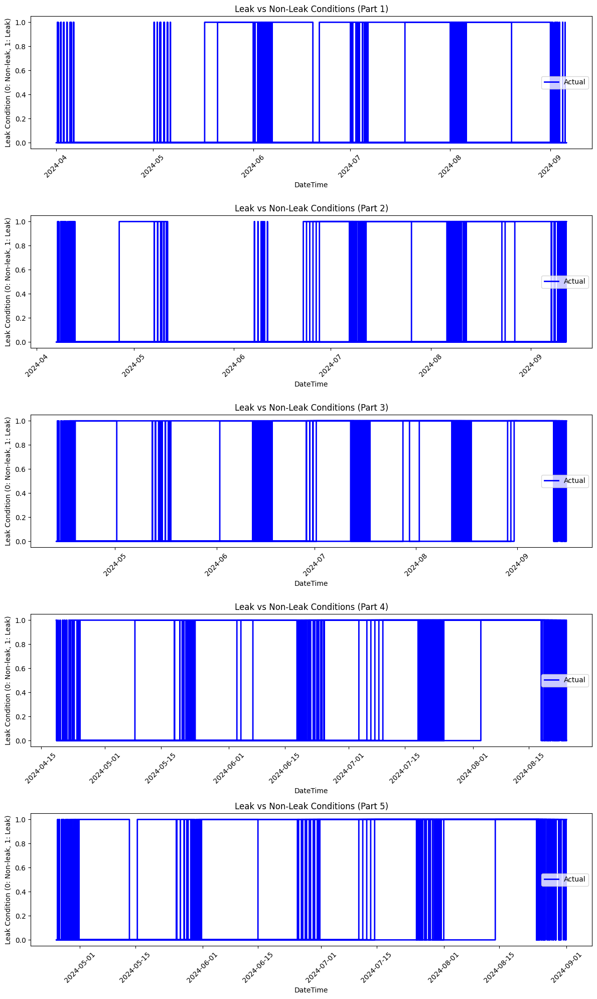

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Assuming your dataframe is called final_df
# Convert formatted_datetime to datetime if not done already
final_df['formatted_datetime'] = pd.to_datetime(final_df['formatted_datetime'], format='%d/%m/%Y %H:%M')

# Split the dataframe into 5 parts
split_dfs = np.array_split(final_df, 5)

# Create a figure with 5 subplots
fig, axs = plt.subplots(5, 1, figsize=(12, 20))

for i, split_df in enumerate(split_dfs):
    # Plot each split in a separate chart
    axs[i].step(split_df['formatted_datetime'], split_df['label'],
                label='Actual', color='blue', linewidth=2, where='mid')

    # Set title and labels for each chart
    axs[i].set_title(f"Leak vs Non-Leak Conditions (Part {i+1})")
    axs[i].set_xlabel("DateTime")
    axs[i].set_ylabel("Leak Condition (0: Non-leak, 1: Leak)")

    # Rotate x-axis labels for better readability
    axs[i].tick_params(axis='x', rotation=45)

    # Display legend
    axs[i].legend()

# Adjust layout to avoid overlapping
plt.tight_layout()
plt.show()


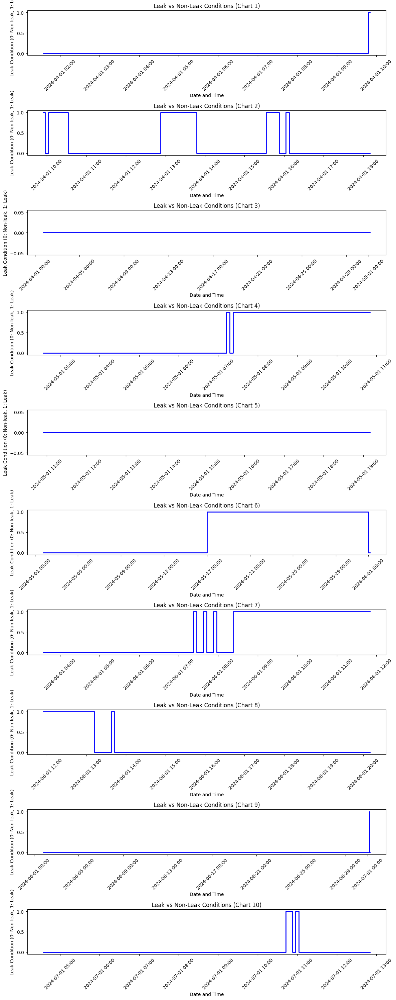

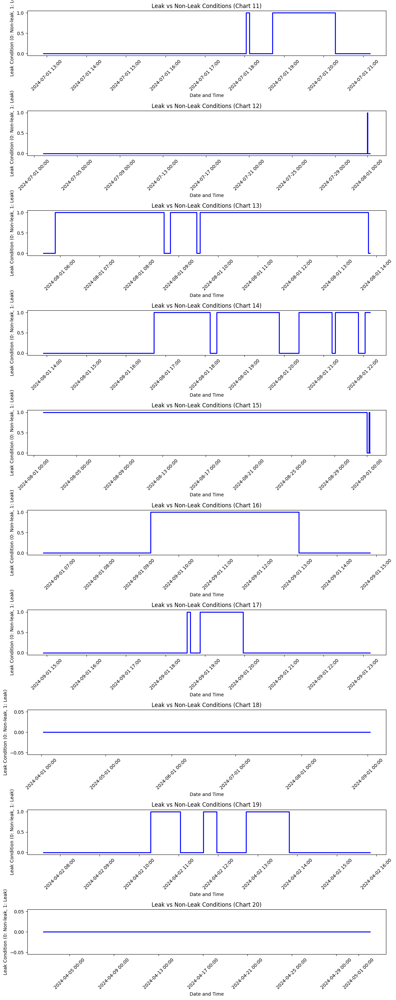

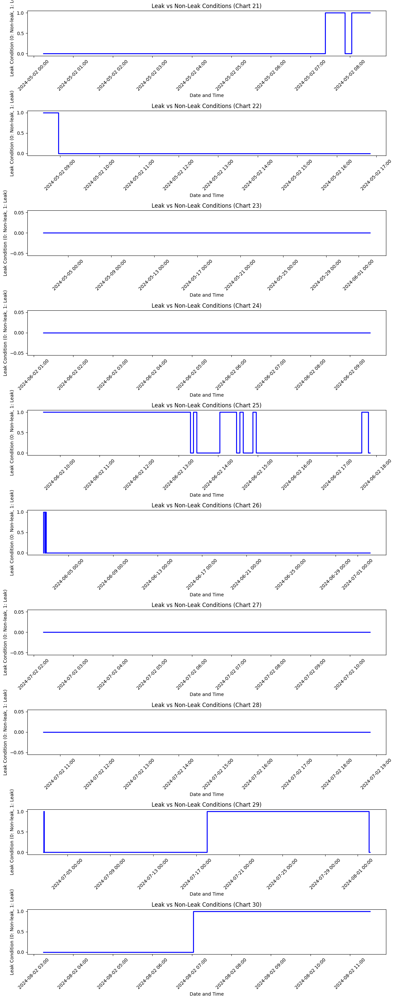

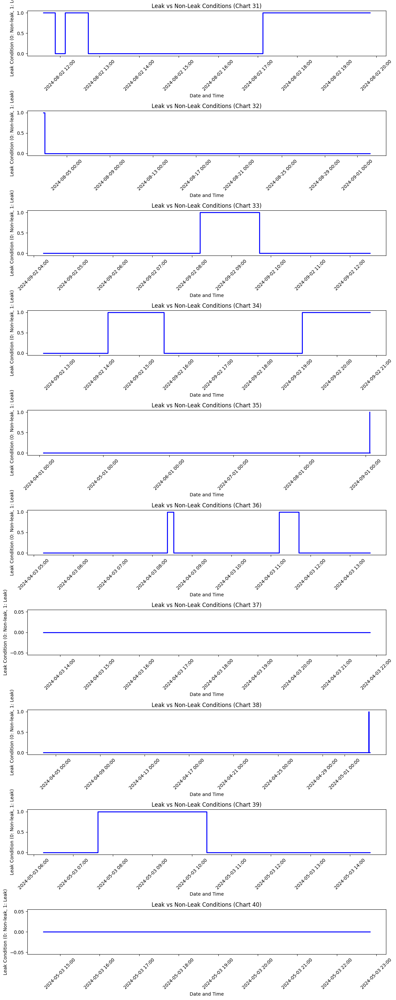

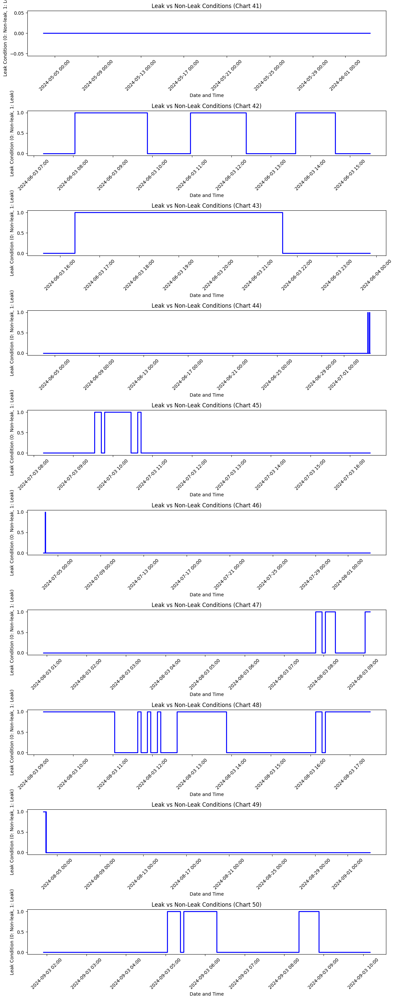

...

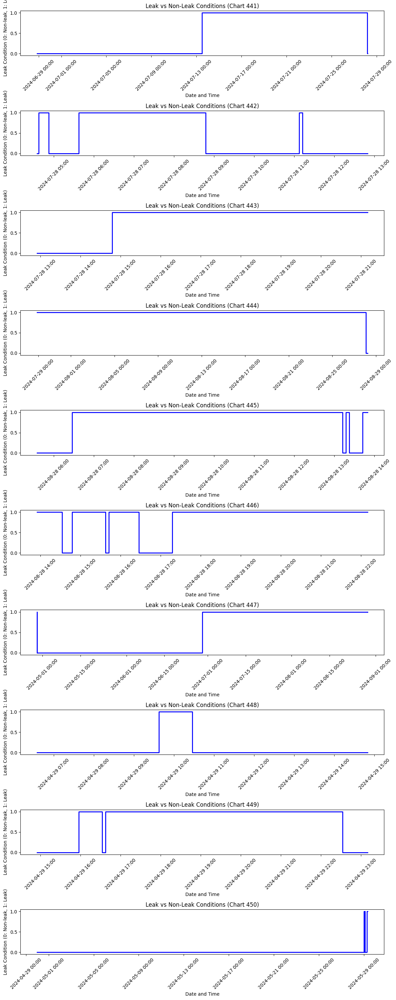

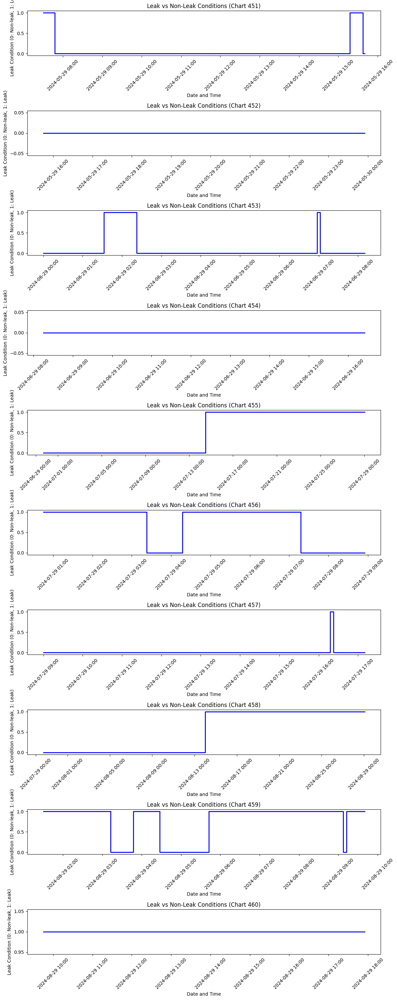

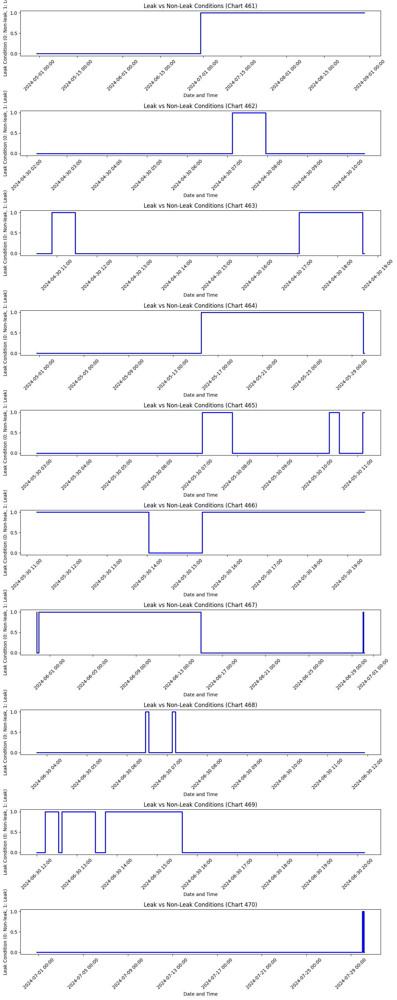

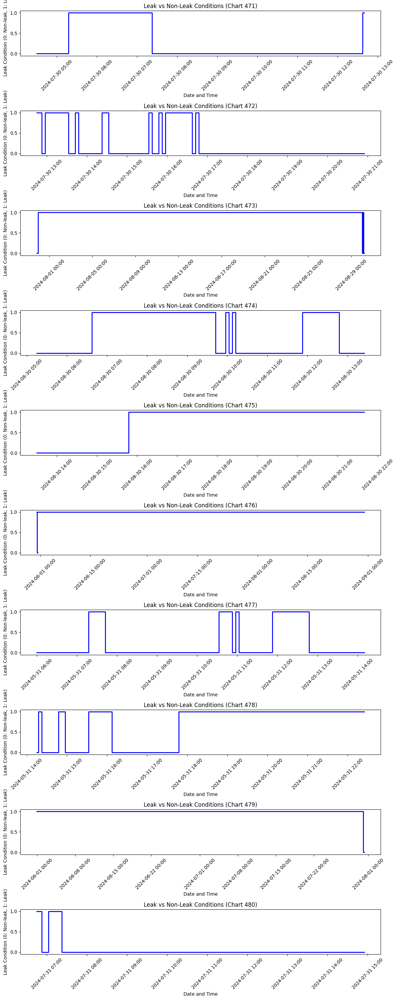

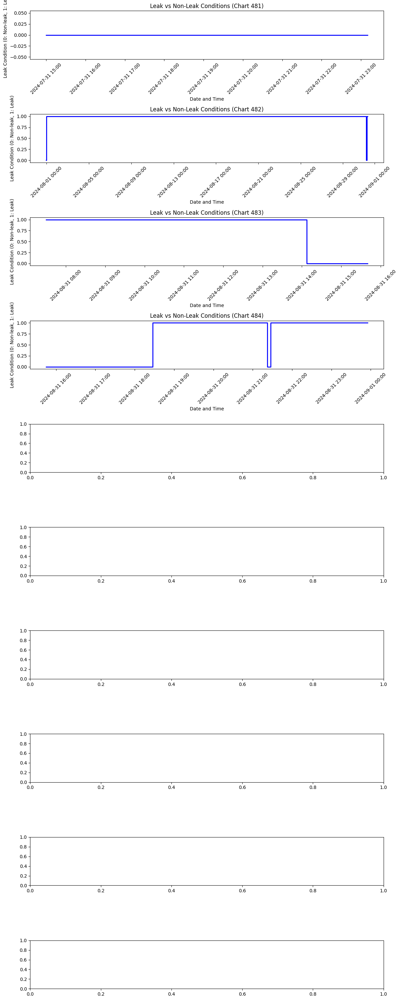

In [ ]:
import matplotlib.dates as mdates

# Assuming your dataframe is called final_df
# Convert formatted_datetime to datetime if not done already
final_df['formatted_datetime'] = pd.to_datetime(final_df['formatted_datetime'], format='%d/%m/%Y %H:%M')

# Define the number of rows per chart
rows_per_chart = 100
charts_per_figure = 10  # Number of charts per figure

# Calculate the number of charts needed
num_charts = int(np.ceil(len(final_df) / rows_per_chart))
num_figures = int(np.ceil(num_charts / charts_per_figure))

# Split the dataframe into parts, each with 100 rows
split_dfs = np.array_split(final_df, num_charts)

# Loop through each figure
for fig_num in range(num_figures):
    # Create a figure with `charts_per_figure` subplots
    fig, axs = plt.subplots(charts_per_figure, 1, figsize=(12, charts_per_figure * 3))

    # If only one chart in a figure, make sure axs is a list
    if charts_per_figure == 1:
        axs = [axs]

    # Get the appropriate subset of split_dfs for this figure
    start_chart = fig_num * charts_per_figure
    end_chart = min(start_chart + charts_per_figure, num_charts)

    for i in range(start_chart, end_chart):
        # Use modulo to get the correct subplot index in axs
        subplot_index = i % charts_per_figure

        # Plot each split in a separate chart
        axs[subplot_index].step(split_dfs[i]['formatted_datetime'], split_dfs[i]['label'], color='blue', linewidth=2, where='mid')

        # Set title and labels for each chart
        axs[subplot_index].set_title(f"Leak vs Non-Leak Conditions (Chart {i+1})")
        axs[subplot_index].set_xlabel("Date and Time")
        axs[subplot_index].set_ylabel("Leak Condition (0: Non-leak, 1: Leak)")

        # Rotate x-axis labels for better readability
        axs[subplot_index].tick_params(axis='x', rotation=45)

        # Set consistent date and time format for x-axis
        axs[subplot_index].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))

        # Display legend
        #axs[subplot_index].legend()

    # Adjust layout to avoid overlapping
    plt.tight_layout()
    plt.show()


In [ ]:
# Save the DataFrame to an Excel file in Google Drive
combined_df.to_excel('/content/drive/My Drive/YVW/test2_job1_input_result_dates.xlsx', index=False)

In [ ]:
from google.colab import files
# Save the modified sensor readings back to an Excel file
output_file = 'test2_job1_input_result.xlsx'
combined_df.to_excel(output_file, index=False, engine='openpyxl')

# Download the modified file
files.download(output_file)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>